# 1. Load in Libraries

In [1]:
#!pip install squarify
#!pip install textacy
#!pip install emot
#!pip install emoji
#!pip3 install pmdarima


import nltk
from nltk.tokenize import word_tokenize  
from nltk.stem import WordNetLemmatizer
from nltk.stem.snowball import SnowballStemmer
from nltk.stem.porter import *
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import spacy
nlp = spacy.load('en_core_web_sm')
from  textacy import preprocessing as tprep
import gensim

import re
from nltk.corpus import stopwords
from nltk.stem.wordnet import WordNetLemmatizer
from sklearn.feature_extraction.text import CountVectorizer, TfidfTransformer
from sklearn.naive_bayes import MultinomialNB
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.metrics import confusion_matrix, classification_report,accuracy_score
import os
#os.chdir('C:/Users/T430/Google Drive/00 - Masters/Disseration/00 - Actual Disseration')
from itertools import chain
import pandas as pd
from nltk import word_tokenize
from nltk import FreqDist
#from emot.emo_unicode import UNICODE_EMOJI, EMOTICONS_EMO
import emoji

In [368]:
SMILEYS = {u":‑)":"Happy_face",
u":-))":"Elated_face",
u":-)))":"Overjoyed_face",
u":)":"Happy_face",
u":))":"Elated_face",
u":)))":"Overjoyed_face",
u":-]":"Happy_face",
u":]":"Happy_face",
u":-3":"Happy_face_",
u":3":"Happy_face_",
u":->":"Happy_face_",
u":>":"Happy_face_",
u"8-)":"Happy_face_",
u":o)":"Happy_face_",
u":-}":"Happy_face_",
u":}":"Happy_face_",
u":-)":"Happy_face_",
u":c)":"Happy_face_",
u":^)":"Happy_face_",
u"=]":"Happy_face_",
u"=)":"Happy_face_",
u":‑D":"Laughing",
u":D":"Laughing",
u"8‑D":"Laughing",
u"8D":"Laughing",
u"X‑D":"Laughing",
u"XD":"Laughing",
u"=D":"Laughing",
u"=3":"Laughing",
u"B^D":"Laughing",
u":-))":"Elated_face",
u":-(":"sad_face",
u":‑(":"sad_face",
u":(":"sad_face",
u":‑c":"sad_face",
u":c":"sad_face",
u":‑<":"sad_face",
u":<":"sad_face",
u":‑[":"sad_face",
u":[":"sad_face",
u":-||":"sad_face",
u">:[":"sad_face",
u":{":"sad_face",
u":@":"sad_face",
u">:(":"sad_face",
u":'‑(":"Crying",
u":'(":"Crying",
u":'‑)":"happy_face",
u":')":"happy_face",
u"D‑':":"Horror",
u"D:<":"Disgust",
u"D:":"Sadness",
u"D8":"Great_dismay",
u"D;":"Great_dismay",
u"D=":"Great_dismay",
u"DX":"Great_dismay",
u":‑O":"Surprise",
u":O":"Surprise",
u":‑o":"Surprise",
u":o":"Surprise",
u":-0":"Shock",
u"8‑0":"Yawn",
u">:O":"Yawn",
u":-*":"Kiss",
u":*":"Kiss",
u":X":"Kiss",
u";‑)":"Wink_or_smirk",
u";)":"Wink_or_smirk",
u"*-)":"Wink_or_smirk",
u"*)":"Wink_or_smirk",
u";‑]":"Wink_or_smirk",
u";]":"Wink_or_smirk",
u";^)":"Wink_or_smirk",
u":‑,":"Wink_or_smirk",
u";D":"Wink_or_smirk",
u":‑P":"Tongue_sticking_out,_cheeky,_playful_or_blowing_a_raspberry",
u":P":"Tongue_sticking_out,_cheeky,_playful_or_blowing_a_raspberry",
u"X‑P":"Tongue_sticking_out,_cheeky,_playful_or_blowing_a_raspberry",
u"XP":"Tongue_sticking_out,_cheeky,_playful_or_blowing_a_raspberry",
u":‑Þ":"Tongue_sticking_out,_cheeky,_playful_or_blowing_a_raspberry",
u":Þ":"Tongue_sticking_out,_cheeky,_playful_or_blowing_a_raspberry",
u":b":"Tongue_sticking_out,_cheeky,_playful_or_blowing_a_raspberry",
u"d:":"Tongue_sticking_out,_cheeky,_playful_or_blowing_a_raspberry",
u"=p":"Tongue_sticking_out,_cheeky,_playful_or_blowing_a_raspberry",
u">:P":"Tongue_sticking_out,_cheeky,_playful_or_blowing_a_raspberry",
u":‑/":"Skeptical,_annoyed,_undecided,_uneasy_or_hesitant",
u":/":"Skeptical,_annoyed,_undecided,_uneasy_or_hesitant",
u":-[.]":"Skeptical,_annoyed,_undecided,_uneasy_or_hesitant",
u">:[(\)]":"Skeptical,_annoyed,_undecided,_uneasy_or_hesitant",
u">:/":"Skeptical,_annoyed,_undecided,_uneasy_or_hesitant",
u":[(\)]":"Skeptical,_annoyed,_undecided,_uneasy_or_hesitant",
u"=/":"Skeptical,_annoyed,_undecided,_uneasy_or_hesitant",
u"=[(\)]":"Skeptical,_annoyed,_undecided,_uneasy_or_hesitant",
u":L":"Skeptical,_annoyed,_undecided,_uneasy_or_hesitant",
u"=L":"Skeptical,_annoyed,_undecided,_uneasy_or_hesitant",
u":S":"Skeptical,_annoyed,_undecided,_uneasy_or_hesitant",
u":‑|":"Straight_face",
u":|":"Straight_face",
u":$":"Embarrassed_or_blushing",
u":‑x":"Sealed_lips_or_wearing_braces_or_tongue-tied",
u":x":"Sealed_lips_or_wearing_braces_or_tongue-tied",
u":‑#":"Sealed_lips_or_wearing_braces_or_tongue-tied",
u":#":"Sealed_lips_or_wearing_braces_or_tongue-tied",
u":‑&":"Sealed_lips_or_wearing_braces_or_tongue-tied",
u":&":"Sealed_lips_or_wearing_braces_or_tongue-tied",
u"O:‑)":"Angel,_saint_or_innocent",
u"O:)":"Angel,_saint_or_innocent",
u"0:‑3":"Angel,_saint_or_innocent",
u"0:3":"Angel,_saint_or_innocent",
u"0:‑)":"Angel,_saint_or_innocent",
u"0:)":"Angel,_saint_or_innocent",
u":‑b":"Tongue_sticking_out,_cheeky,_playful_or_blowing_a_raspberry",
u"0;^)":"Angel,_saint_or_innocent",
u">:‑)":"Evil_or_devilish",
u">:)":"Evil_or_devilish",
u"}:‑)":"Evil_or_devilish",
u"}:)":"Evil_or_devilish",
u"3:‑)":"Evil_or_devilish",
u"3:)":"Evil_or_devilish",
u">;)":"Evil_or_devilish",
u"|;‑)":"Cool",
u"|‑O":"Bored",
u":‑J":"Tongue-in-cheek",
u"#‑)":"Party_all_night",
u"%‑)":"Drunk_or_confused",
u"%)":"Drunk_or_confused",
u":-###..":"Being_sick",
u":###..":"Being_sick",
u"<:‑|":"Dump",
u"(>_<)":"Troubled",
u"(>_<)>":"Troubled",
u"(';')":"Baby",
u"(^^>``":"Nervous_or_Embarrassed_or_Troubled_or_Shy_or_Sweat_drop",
u"(^_^;)":"Nervous_or_Embarrassed_or_Troubled_or_Shy_or_Sweat_drop",
u"(-_-;)":"Nervous_or_Embarrassed_or_Troubled_or_Shy_or_Sweat_drop",
u"(~_~;)_(・.・;)":"Nervous_or_Embarrassed_or_Troubled_or_Shy_or_Sweat_drop",
u"(-_-)zzz":"Sleeping",
u"(^_-)":"Wink",
u"((+_+))":"Confused",
u"(+o+)":"Confused",
u"(o|o)":"Ultraman",
u"^_^":"Joyful",
u"(^_^)/":"Joyful",
u"(^O^)／":"Joyful",
u"(^o^)／":"Joyful",
u"(__)":"Kowtow_as_a_sign_of_respect,_or_dogeza_for_apology",
u"_(._.)_":"Kowtow_as_a_sign_of_respect,_or_dogeza_for_apology",
u"<(___)>":"Kowtow_as_a_sign_of_respect,_or_dogeza_for_apology",
u"<m(__)m>":"Kowtow_as_a_sign_of_respect,_or_dogeza_for_apology",
u"m(__)m":"Kowtow_as_a_sign_of_respect,_or_dogeza_for_apology",
u"m(___)m":"Kowtow_as_a_sign_of_respect,_or_dogeza_for_apology",
u"('_')":"Sad_or_Crying",
u"(/_;)":"Sad_or_Crying",
u"(T_T)_(;_;)":"Sad_or_Crying",
u"(;_;":"Sad_of_Crying",
u"(;_:)":"Sad_or_Crying",
u"(;O;)":"Sad_or_Crying",
u"(:_;)":"Sad_or_Crying",
u"(ToT)":"Sad_or_Crying",
u";_;":"Sad_or_Crying",
u";-;":"Sad_or_Crying",
u";n;":"Sad_or_Crying",
u";;":"Sad_or_Crying",
u"Q.Q":"Sad_or_Crying",
u"T.T":"Sad_or_Crying",
u"QQ":"Sad_or_Crying",
u"Q_Q":"Sad_or_Crying",
u"(-.-)":"Shame",
u"(-_-)":"Shame",
u"(一一)":"Shame",
u"(；一_一)":"Shame",
u"(=_=)":"Tired",
u"(=^·^=)":"cat",
u"(=^··^=)":"cat",
u"=_^=_":"cat",
u"(..)":"Looking_down",
u"(._.)":"Looking_down",
u"^m^":"Giggling_with_hand_covering_mouth",
u"(・・?":"Confusion",
u"(?_?)":"Confusion",
u">^_^<":"Normal_Laugh",
u"<^!^>":"Normal_Laugh",
u"^/^":"Normal_Laugh",
u"（*^_^*）":"Normal_Laugh",
u"(^<^)_(^.^)":"Normal_Laugh",
u"(^^)":"Normal_Laugh",
u"(^.^)":"Normal_Laugh",
u"(^_^.)":"Normal_Laugh",
u"(^_^)":"Normal_Laugh",
u"(^^)":"Normal_Laugh",
u"(^J^)":"Normal_Laugh",
u"(*^.^*)":"Normal_Laugh",
u"(^—^）":"Normal_Laugh",
u"(#^.^#)":"Normal_Laugh",
u"（^—^）":"Waving",
u"(;_;)/~~~":"Waving",
u"(^.^)/~~~":"Waving",
u"(-_-)/~~~_($··)/~~~":"Waving",
u"(T_T)/~~~":"Waving",
u"(ToT)/~~~":"Waving",
u"(*^0^*)":"Excited",
u"(*_*)":"Amazed",
u"(*_*;":"Amazed",
u"(+_+)_(@_@)":"Amazed",
u"(*^^)v":"Laughing,Cheerful",
u"(^_^)v":"Laughing,Cheerful",
u"((d[-_-]b))":"Headphones,Listening_to_music",
u'(-"-)':"Worried",
u"(ーー;)":"Worried",
u"(^0_0^)":"Eyeglasses",
u"(＾ｖ＾)":"Happy",
u"(＾ｕ＾)":"Happy",
u"(^)o(^)":"Happy",
u"(^O^)":"Happy",
u"(^o^)":"Happy",
u")^o^(":"Happy",
u":O_o_O":"Surprised",
u"o_0":"Surprised",
u"o.O":"Surpised",
u"(o.o)":"Surprised",
u"oO":"Surprised",
u"(*￣m￣)":"Dissatisfied",
u"(‘A`)":"Snubbed_or_Deflated"
          }


# 2. Open up the data

In [369]:
params = {'Asset tags': 'btc|bitcoin',
          'Asset name': 'btc', #this will appear in the folder name so can determine what is trained on
          'Remove list' :[
              'btc',
              'bitcoin', 
              'crypto', 
              'cryptocurrency',
              'coin'
                          
                          
                        ],
          'num_topics': 15
}

In [297]:



df.iloc[8895]['text'].replace("’","")

'dont trade in bitcoin, litecoin, cbn orders banks'

In [301]:
text = "don't do it fucker"
#text
text.replace("'","")

'dont do it fucker'

In [327]:
bigram[docs[1]]

['and',
 'when',
 'people',
 'ask',
 'who',
 'do',
 'you',
 'think',
 'you',
 'be',
 'princess_medium',
 'dark_skin_tone',
 'and',
 'youre',
 'you',
 'so',
 'shut',
 'the',
 'fuck',
 'up',
 'princess_medium',
 'dark_skin_tone',
 'princess_medium',
 'dark_skin_tone',
 'princess_medium',
 'dark_skin_tone']

In [328]:
#docs

In [361]:

docs = array(df['text5'])


#more preprocessing of the docs
from nltk.stem.wordnet import WordNetLemmatizer
from nltk.tokenize import RegexpTokenizer
from nltk.tokenize import TweetTokenizer

def docs_preprocessor(docs):
    tokenizer = TweetTokenizer()
    for idx in range(len(docs)):
        docs[idx] = docs[idx].lower()  # Convert to lowercase.
        docs[idx] = tokenizer.tokenize(docs[idx])  # Split into words.

    # Remove numbers, but not words that contain numbers.
    docs = [[token for token in doc if not token.isdigit()] for doc in docs]
    
    # Remove words that are only one character.
    docs = [[token for token in doc if len(token) > 1] for doc in docs]
    
    # Lemmatize all words in documents.
    #lemmatizer = WordNetLemmatizer()
    #docs = [[lemmatizer.lemmatize(token) for token in doc] for doc in docs]
  
    return docs
docs = docs_preprocessor(docs)

# from gensim.models import Phrases
# # Add bigrams and trigrams to docs (only ones that appear 10 times or more).
# bigram = Phrases(docs, min_count=30)
# trigram = Phrases(bigram[docs])

# for idx in range(len(docs)):
#     for token in bigram[docs[idx]]:
#         if '_' in token:
#             # Token is a bigram, add to document.
#             docs[idx].append(token)
#     for token in trigram[docs[idx]]:
#         if '_' in token:
#             # Token is a bigram, add to document.id2word
#             docs[idx].append(token)

In [354]:
bigram[docs[]]

['tiger',
 'have',
 'share',
 'in',
 'so',
 'his',
 'wife',
 'shouldnt',
 'be',
 'eligible',
 'to',
 'win',
 'the',
 'condo',
 'face_with_tears_of_joy',
 'loudly_crying_face_loudly_crying_face']

In [362]:

from gensim.models import Phrases
# Add bigrams and trigrams to docs (only ones that appear 10 times or more).
bigram = Phrases(docs, min_count=30)
trigram = Phrases(bigram[docs])

# for idx in range(len(docs)):
#     for token in bigram[docs[idx]]:
#         if '_' in token:
#             # Token is a bigram, add to document.
#             docs[idx].append(token)
#     for token in trigram[docs[idx]]:
#         if '_' in token:
#             # Token is a bigram, add to document.id2word
#             docs[idx].append(token)

In [363]:
for idx in range(len(docs)):
    for token in trigram[docs[idx]]:
        if '_' in token:
            # Token is a bigram, add to document.
            docs[idx].append(token)


In [360]:
# for ngrams, _ in trigram.vocab.items():
#     unicode_ngrams = ngrams.decode('utf-8')
#     if '_' in unicode_ngrams:
#         print(unicode_ngrams)

In [323]:
df[df.text5.str.contains('do_nt')]

,date,text,text1,count_num,text2,text3,text4,text5


In [302]:
test = {key: value for key, value in nlp.tokenizer.rules.items() if "'" not in key and "’" not in key and "‘" not in key}

In [312]:
# nlp.tokenizer.rules

In [370]:
from datetime import datetime as dt
import os
mask = "D-%y%m%d-T-%H.%M.%S"
print("here")
dte = dt.now().strftime(mask)

results_folder = "results/" + params['Asset name'] + "/" + params['Asset name'] + dte
num_topics = params['num_topics']
os.makedirs(f"{results_folder}")
import pandas as pd

df = pd.read_csv(f'data/ryan_bitcoin_data_new.csv')
   



#df = df[~df.text.str.contains(r'[0-9]')]

#reset index
df = df.reset_index(drop=True)

def emoticons(text):
    words = text.split()
    reformed = [SMILEYS[word] if word in SMILEYS else word for word in words]
    text = " ".join(reformed)
    return text

df['text1'] = df['text'].map(emoticons)

def demojise(tweet):
    tweet = emoji.demojize(tweet)
    tweet = tweet.replace(":"," ")
    tweet = ' '.join(tweet.split())
    return tweet
df['text1'] = df['text'].map(demojise)

#program to clean tweets
import html

def clean(text):
    # convert html escapes like &amp; to characters.
    text = html.unescape(text)
    # tags like <tab>
    text = re.sub(r'<[^<>]*>', ' ', text)
    # markdown URLs like [Some text](https://....)
    text = re.sub(r'\[([^\[\]]*)\]\([^\(\)]*\)', r'\1', text)
    # text or code in brackets like [0]
    text = re.sub(r'\[[^\[\]]*\]', ' ', text)
    # standalone sequences of specials, matches &# but not #cool
    text = re.sub(r'(?:^|\s)[&#<>{}\[\]+|\\:-]{1,}(?:\s|$)', ' ', text)
    # standalone sequences of hyphens like --- or ==
    text = re.sub(r'(?:^|\s)[\-=\+]{2,}(?:\s|$)', ' ', text)
    # sequences of white spaces
    text = re.sub(r'\s+', ' ', text)
    #no hashtags
    #text = re.sub('\#[\w\_]+',' ', text)
    #no dollar
    text = re.sub('\$[\w\_]+',' ', text)
    text = text.replace("`","")
    text = text.replace("´","")
    text = text.replace("’","")
    text = text.replace("'","")
    #for bigrams and trigrams to work, need to replace _ with something else
    text = text.replace(".","_")
    return text.strip()

#apply clean
df['text1'] = df['text1'].map(clean)

here


here
here
Populating the interactive namespace from numpy and matplotlib
here
exported clean data
here
Number of unique words in initital documents: 45807
Number of unique words after removing rare and common words: 12975
[(4, [('number', 0.02598752598752599), ('rt', 0.02338877338877339), ('news', 0.02104989604989605), ('escort', 0.020703395703395702), ('google', 0.020356895356895357), ('website', 0.018711018711018712), ('video', 0.017758142758142758), ('usa', 0.016372141372141373), ('eeuu', 0.015505890505890506), ('nowplaye', 0.014986139986139986)]), (13, [('fee', 0.06947873799725651), ('rate', 0.05768175582990398), ('sit', 0.05720164609053498), ('vbyte', 0.047325102880658436), ('hour', 0.04663923182441701), ('block', 0.04128943758573388), ('transaction', 0.03559670781893004), ('sit_vbyte', 0.03155006858710562), ('fee_rate', 0.03155006858710562), ('smiling.face.with.sunglasse', 0.02338820301783265)]), (12, [('term', 0.03964027331189711), ('long', 0.038534967845659164), ('future', 0.03

Loading BokehJS ...

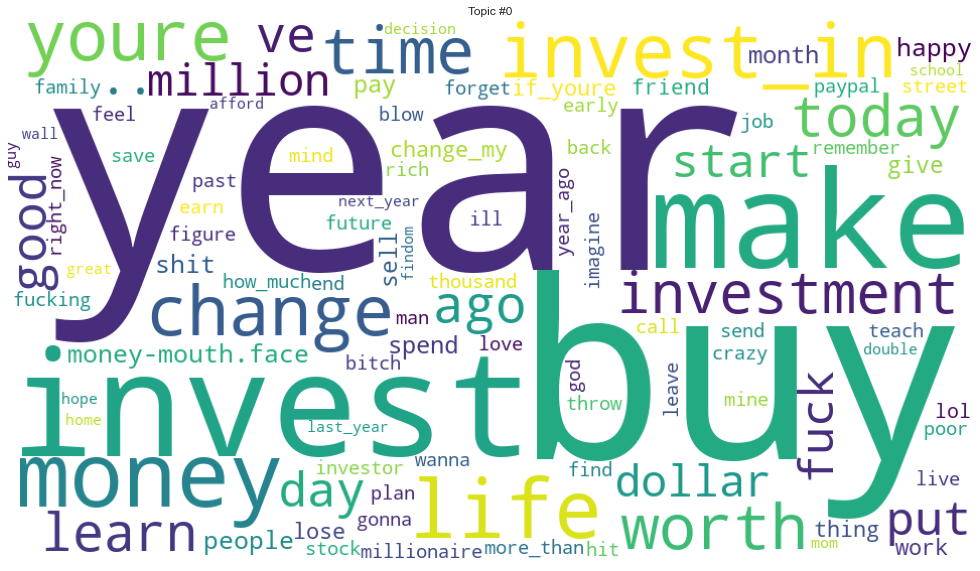

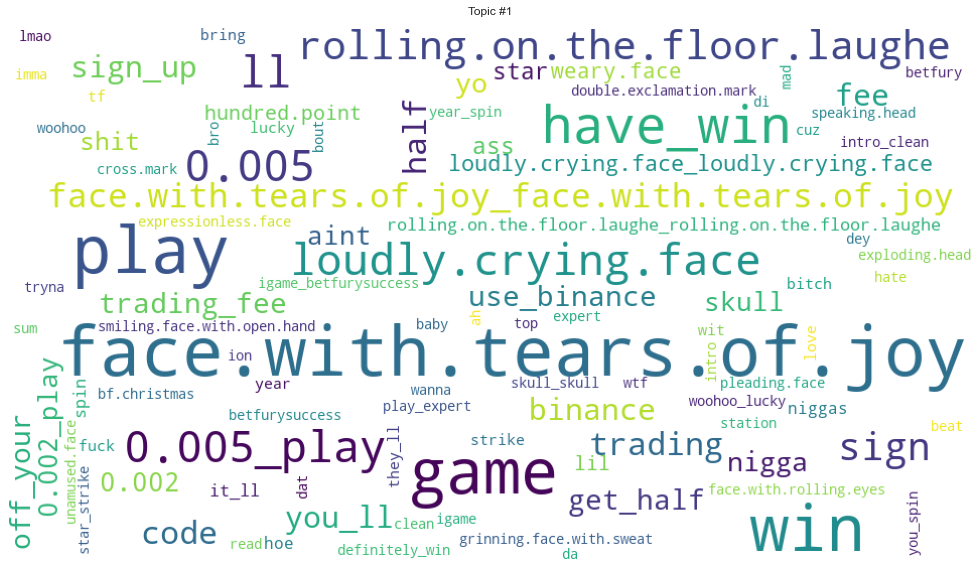

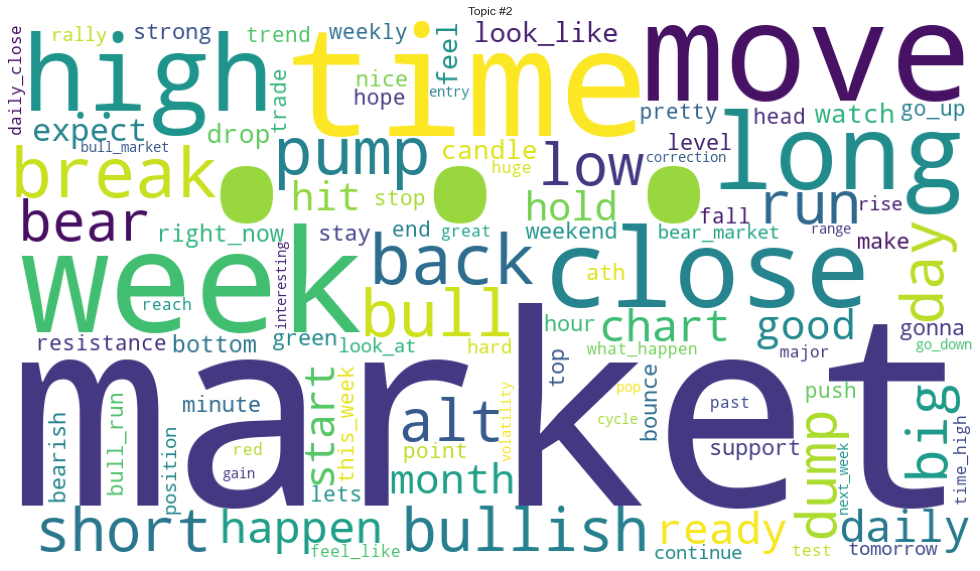

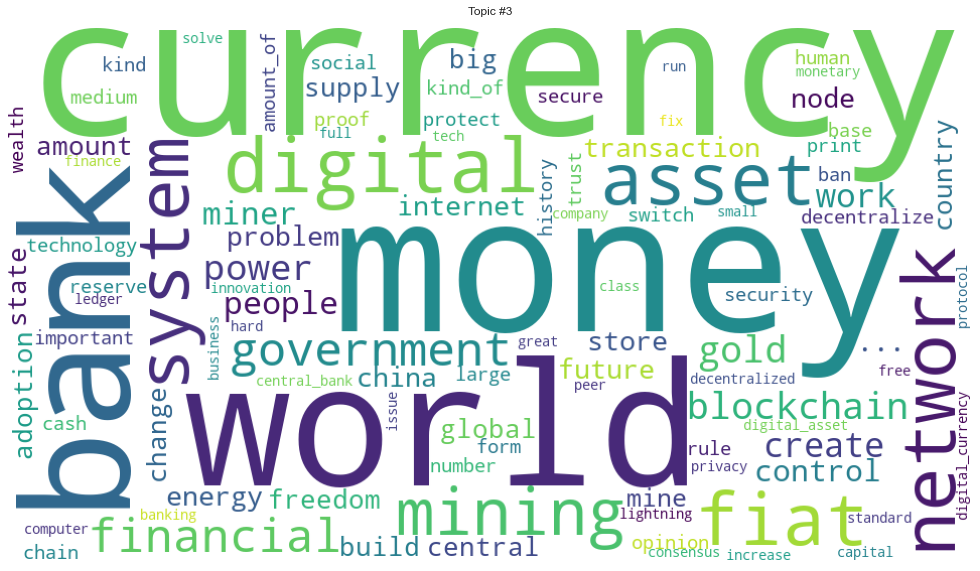

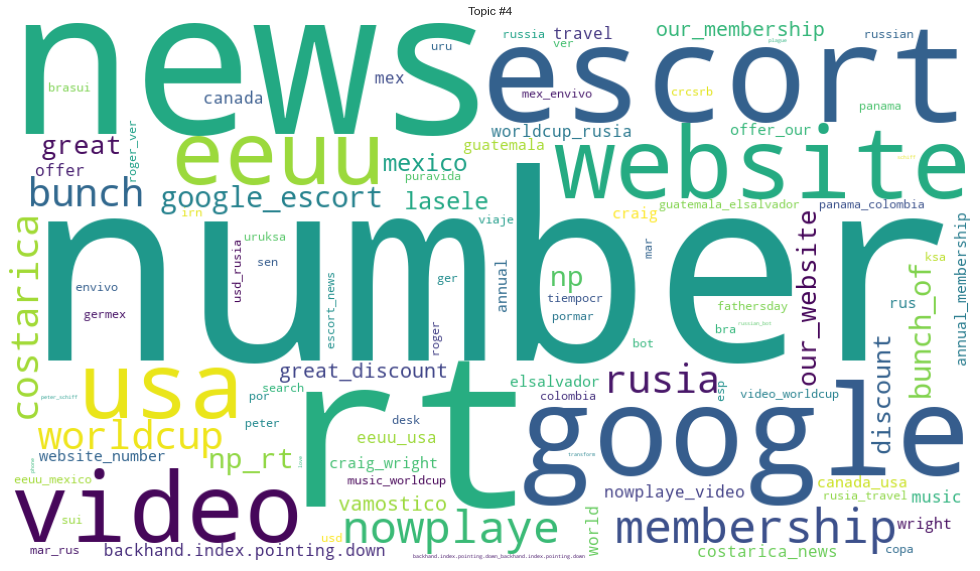

...

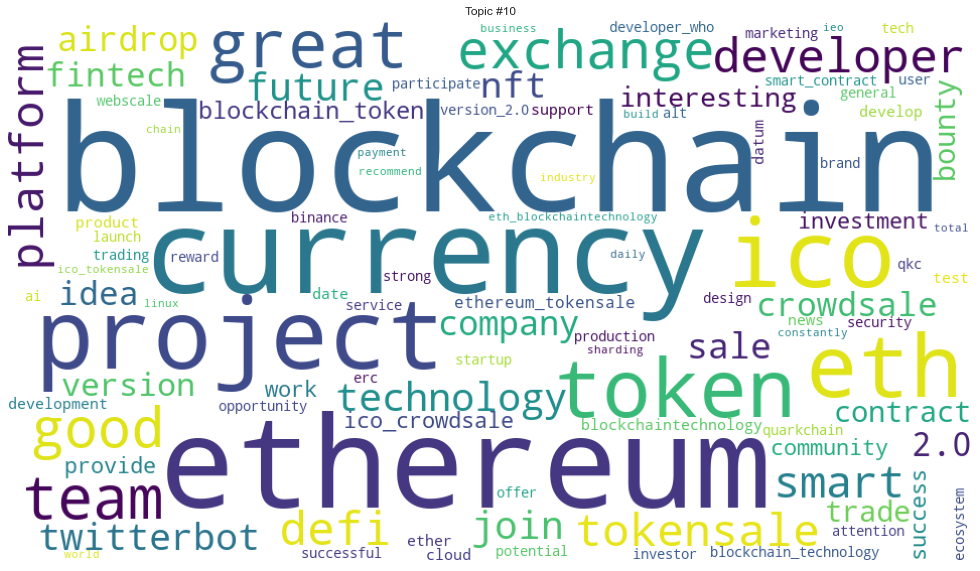

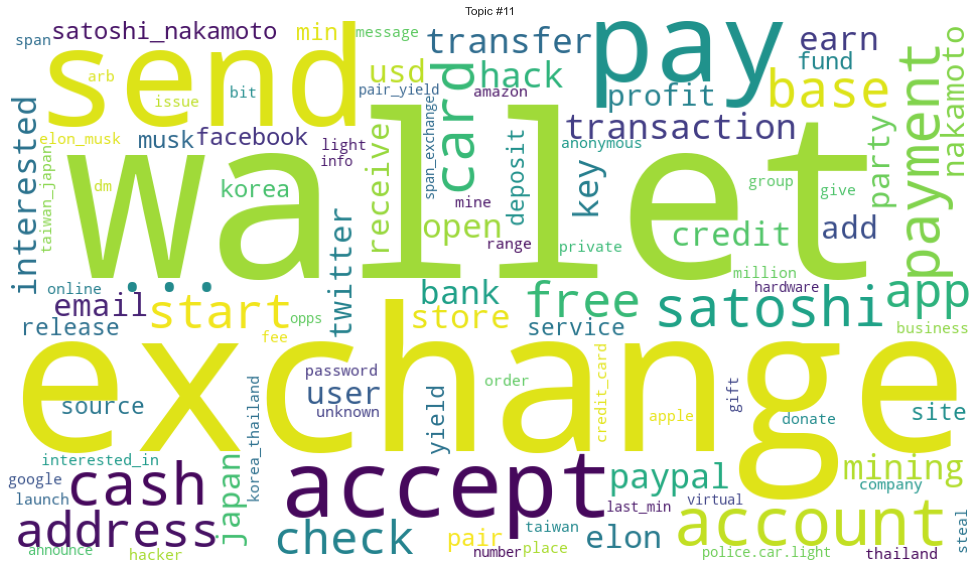

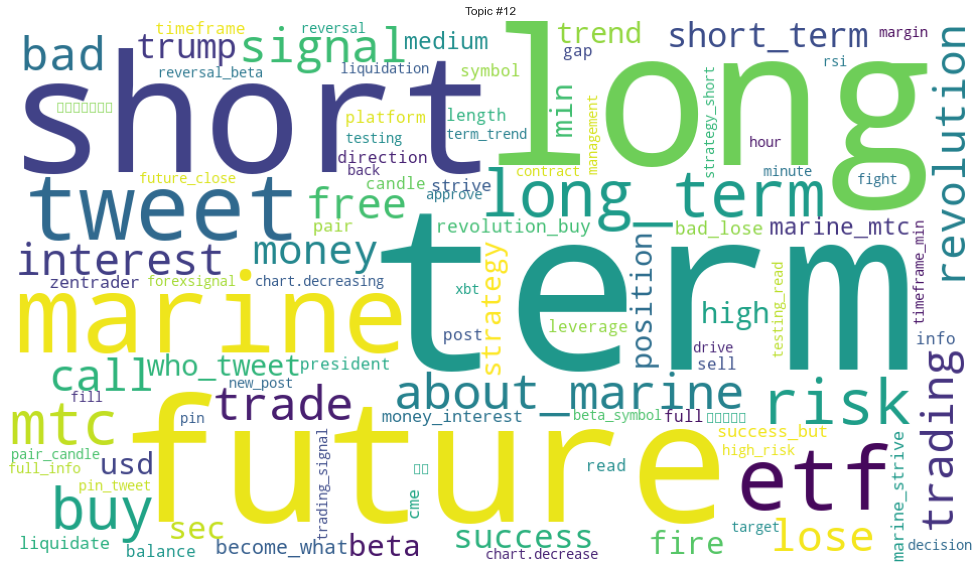

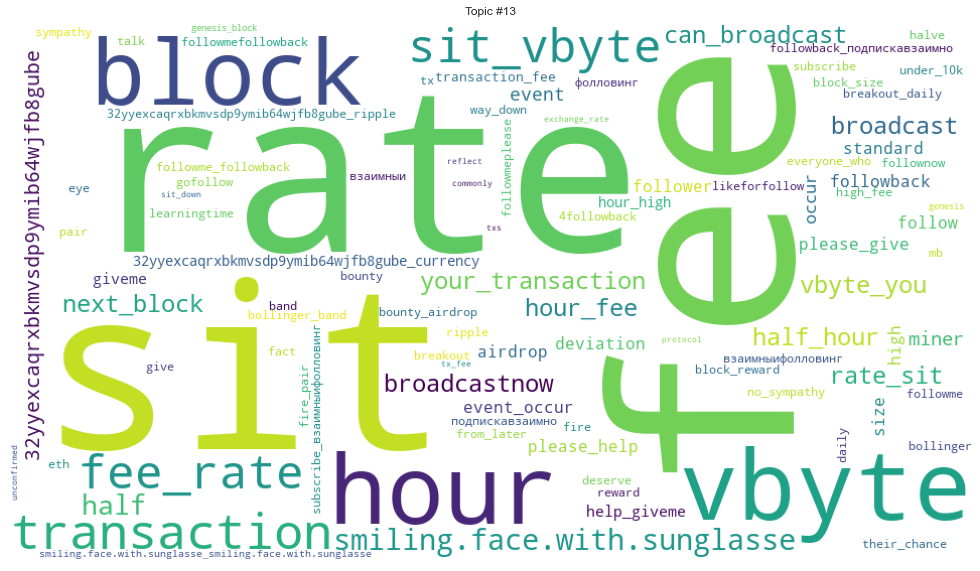

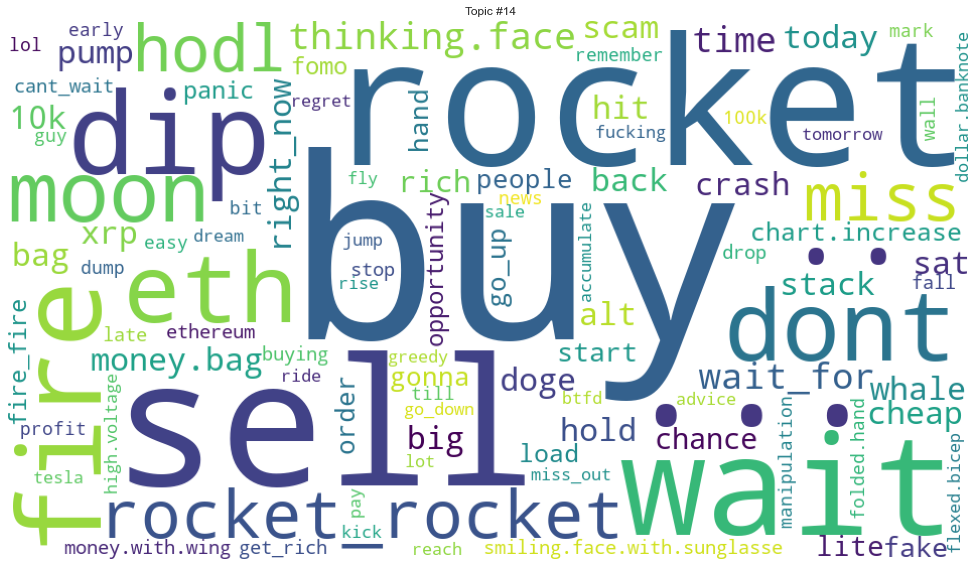

In [372]:
from datetime import datetime as dt
import os
mask = "D-%y%m%d-T-%H.%M.%S"
print("here")
dte = dt.now().strftime(mask)

results_folder = "results/" + params['Asset name'] + "/" + params['Asset name'] + dte
num_topics = params['num_topics']
os.makedirs(f"{results_folder}")
import pandas as pd

df = pd.read_csv(f'data/ryan_bitcoin_data_new.csv')
   



#df = df[~df.text.str.contains(r'[0-9]')]

#reset index
df = df.reset_index(drop=True)

def emoticons(text):
    words = text.split()
    reformed = [SMILEYS[word] if word in SMILEYS else word for word in words]
    text = " ".join(reformed)
    return text

df['text1'] = df['text'].map(emoticons)

def demojise(tweet):
    tweet = emoji.demojize(tweet)
    tweet = tweet.replace(":"," ")
    tweet = ' '.join(tweet.split())
    return tweet
df['text1'] = df['text'].map(demojise)

#program to clean tweets
import html

def clean(text):
    # convert html escapes like &amp; to characters.
    text = html.unescape(text)
    # tags like <tab>
    text = re.sub(r'<[^<>]*>', ' ', text)
    # markdown URLs like [Some text](https://....)
    text = re.sub(r'\[([^\[\]]*)\]\([^\(\)]*\)', r'\1', text)
    # text or code in brackets like [0]
    text = re.sub(r'\[[^\[\]]*\]', ' ', text)
    # standalone sequences of specials, matches &# but not #cool
    text = re.sub(r'(?:^|\s)[&#<>{}\[\]+|\\:-]{1,}(?:\s|$)', ' ', text)
    # standalone sequences of hyphens like --- or ==
    text = re.sub(r'(?:^|\s)[\-=\+]{2,}(?:\s|$)', ' ', text)
    # sequences of white spaces
    text = re.sub(r'\s+', ' ', text)
    #no hashtags
    #text = re.sub('\#[\w\_]+',' ', text)
    #no dollar
    text = re.sub('\$[\w\_]+',' ', text)
    text = text.replace("`","")
    text = text.replace("´","")
    text = text.replace("’","")
    text = text.replace("'","")
    #for bigrams and trigrams to work, need to replace _ with something else
    text = text.replace("_",".")
    return text.strip()

#apply clean
df['text1'] = df['text1'].map(clean)

from  textacy import preprocessing as tprep
def normalise(text):
    text = tprep.normalize.hyphenated_words(text)
    text = tprep.normalize.quotation_marks(text)
    text = tprep.normalize.unicode(text)
    text = tprep.remove.accents(text)
    return text

df['text1'] = df['text1'].map(normalise)


#convert to lowercase
df = df.applymap(lambda s:s.lower() if type(s) == str else s) #convert all to lowercase

print("here")

#remove tweets that aren't useful
df = df[~df.text1.str.contains('Current price:')]
df = df[~df.text1.str.contains('Current price')]
df = df[~df.text1.str.contains('current price')]
df = df[~df.text1.str.contains('current rate:')]
df = df[~df.text1.str.contains('Current rate:')]
df = df[~df.text1.str.contains('volume alert')]
df = df[~df.text1.str.contains('price update')]
df = df[~df.text1.str.contains('prices update')]
df = df[~df.text1.str.contains('price action')]
df = df[~df.text1.str.contains('price action')]
df = df[~df.text1.str.contains('price increase')]
df = df[~df.text1.str.contains('price decrease')]
df = df[~df.text1.str.contains('density')]
#df = df[~df.text1.str.contains('volume')]
df = df[~df.text1.str.contains('last hour')]
df = df[~df.text1.str.contains('latest block info')]
df = df[~df.text1.str.contains('closed sell')]
df = df[~df.text1.str.contains('alert')]
df = df[~df.text1.str.contains('hourly update')]
df = df[~df.text1.str.contains('%')]


searchfor = ['current', 'price']
df = df[~df.text1.str.contains('|'.join(searchfor))]



df = df.reset_index(drop=True)

#keep tweets that are of interest for that asset
#df_btc = df[df.text1.str.contains(params['Asset tags'], na=False)]
df_btc = df 
df_btc = df_btc.reset_index(drop=True)

#delete words i don't think are useful to the analysis
import re
To_remove_lst = params['Remove list']
p = re.compile('|'.join(map(re.escape, To_remove_lst)))
df_btc['text1'] = [p.sub('', text) for text in df_btc['text1']] 

#get rid of tweets that have 10 or more numbers, these are tweets that just report value
def count_digits(string):
    return sum(item.isdigit() for item in string)


df_btc['count_num'] = df_btc['text'].apply(count_digits)
df_btc = df_btc[['date','text', 'text1', 'count_num']].loc[df_btc['count_num'] < 10] # so take it to be >= get rid 
df_btc = df_btc.reset_index(drop=True)


#sample down for speed
#df = df_btc.sample(frac=0.2, replace=False)
#df.to_csv(f'{results_folder}/00 - Initial sample DF.csv')
df=df_btc
df = df.reset_index(drop=True)

nlp.tokenizer.rules = {key: value for key, value in nlp.tokenizer.rules.items() if "'" not in key and "’" not in key and "‘" not in key}



test = nlp.tokenizer.rules
#del test['gonna'][0][65]
#del test['gonna'][1][65]
#del test['Gonna'][0][65]
#del test['Gonna'][1][65]



del test["gonna"]
del test["dont"]
del test["cant"]
del test["havent"]
del test["shouldnt"]
del test["aint"]
del test["wont"]
del test["youre"]

nlp.tokenizer.rules = test

#delete stopwords
df['text2'] = df['text1'].map(nlp)
#KEEP STOP WORDS ACCORDING TO STUDY IT'S BETTER FOR STOP WORDS AND I THINK IT'S BETTER FOR SENTIMENT ANALYSIS
# def stop_words(doc):
#     non_stop = [t for t in doc if not t.is_stop and not t.is_punct]
#     return non_stop
# df['text3'] = df['text2'].map(stop_words)
df['text3'] = df['text2']

#my own lemmatisation because looks like the one below doesnt work
def lemma(doc):
    doclems = [t.lemma_ for t in doc]
    return doclems
df['text4'] = df['text3'].map(lemma)
#df['text4'] = df['text3']
%pylab inline
print("here")
import pandas as pd
import pickle as pk
from scipy import sparse as sp

#converting to a string
df['text5'] = [' '.join(map(str, l)) for l in df['text4']]

cleandf = df[['text5']]
cleandf.to_csv(f'{results_folder}/00 - Cleaned Text.csv')
print("exported clean data")

docs = array(df['text5'])


#more preprocessing of the docs
from nltk.stem.wordnet import WordNetLemmatizer
from nltk.tokenize import RegexpTokenizer
from nltk.tokenize import TweetTokenizer

def docs_preprocessor(docs):
    tokenizer = TweetTokenizer()
    for idx in range(len(docs)):
        docs[idx] = docs[idx].lower()  # Convert to lowercase.
        docs[idx] = tokenizer.tokenize(docs[idx])  # Split into words.

    # Remove numbers, but not words that contain numbers.
    docs = [[token for token in doc if not token.isdigit()] for doc in docs]
    
    # Remove words that are only one character.
    docs = [[token for token in doc if len(token) > 1] for doc in docs]
    
    # Lemmatize all words in documents.
    #lemmatizer = WordNetLemmatizer()
    #docs = [[lemmatizer.lemmatize(token) for token in doc] for doc in docs]
  
    return docs
docs = docs_preprocessor(docs)

from gensim.models import Phrases
# Add bigrams and trigrams to docs (only ones that appear 10 times or more).
bigram = Phrases(docs, min_count=30)
trigram = Phrases(bigram[docs])

for idx in range(len(docs)):
    for token in trigram[docs[idx]]:
        if '_' in token:
            # Token is a bigram, add to document.
            docs[idx].append(token)

            
from gensim.corpora import Dictionary
print("here")
# Create a dictionary representation of the documents.
dictionary = Dictionary(docs)

print('Number of unique words in initital documents:', len(dictionary))

# Filter out words that occur less than 10 documents, or more than 3% of the documents. The original here was 20% 

dictionary.filter_extremes(no_below=5, no_above=0.8)
dictionary.save_as_text(f'{results_folder}/dict_text.txt') 

print('Number of unique words after removing rare and common words:', len(dictionary))


temp = dictionary[0]
id2word = dictionary.id2token

#-----------------------------------------------------------------------------------------------------------------------------------------------


corpus = [dictionary.doc2bow(doc) for doc in docs]


from gensim.models import LdaModel
import os





# from gensim.models.ldamulticore import LdaMulticore
# lda_para_model_n = []
# for n in range(3, 30):
#     lda_model_c = LdaMulticore(corpus=corpus, id2word=id2word, chunksize=2000, eta='auto', iterations=400, num_topics=n, passes=20, eval_every=None,random_state=42)
#     lda_coherence = CoherenceModel(model=lda_model_c, texts=docs,dictionary=dictionary, coherence='c_v')
#     lda_para_model_n.append((n, lda_model_c, lda_coherence.get_coherence()))
# fig = pd.DataFrame(lda_para_model_n, columns=["n", "model","coherence"]).set_index("n")[["coherence"]].plot(figsize=(16,9))
# bestco_df= pd.DataFrame(lda_para_model_n, columns=["n", "model","coherence"]).set_index("n")[["coherence"]]
# bestco_df.to_csv(f'{results_folder}/00a - Best Coherence.csv')
# fig = pd.DataFrame(lda_para_model_n, columns=["n", "model","coherence"]).set_index("n")[["coherence"]].plot(figsize=(16,9))
# plt.title('Coherence Score (CV) across the number of topics chosen in each model', fontsize=20)
# plt.xlabel('Number of topics', fontsize=20)
# plt.ylabel('Coherence score', fontsize=20)
# plt.tick_params(axis='x', labelsize=16)
# plt.tick_params(axis='y', labelsize=16)
# fig.figure.savefig(f'{results_folder}/Best_coherence_cv.png')
# bestop = bestco_df.idxmax()[0]










from gensim.models.wrappers import LdaMallet
os.environ.update({'MALLET_HOME':r'C:/new_mallet/mallet-2.0.8'}) 
#You should update this path as per the path of Mallet directory on your system.
mallet_path = r'C:\\new_mallet\\mallet-2.0.8\\bin\\mallet' 
#You should update this path as per the path of Mallet directory on your system.

temp = dictionary[0]  # This is only to "load" the dictionary.


ldamallet = gensim.models.wrappers.LdaMallet(mallet_path, corpus=corpus, num_topics=num_topics, id2word=id2word, optimize_interval=50)
import pprint
print(ldamallet.show_topics(formatted=False))


model2 = gensim.models.wrappers.ldamallet.malletmodel2ldamodel(ldamallet)
from gensim.models.coherencemodel import CoherenceModel

lda_gensim_para_coherence = CoherenceModel(model=model2,
    texts=docs, dictionary=dictionary, coherence='c_v')
lda_gensim_para_coherence_score = lda_gensim_para_coherence.get_coherence()




print(lda_gensim_para_coherence_score)

#pyLDAvis.gensim_models.prepare(model2, corpus, dictionary)

print("here")
data = df.text.values.tolist()
def format_topics_sentences(ldamodel=None, corpus=corpus, texts=data):
    # Init output
    sent_topics_df = pd.DataFrame()

    # Get main topic in each document
    for i, row_list in enumerate(ldamodel[corpus]):
        row = row_list[0] if ldamodel.per_word_topics else row_list            
        # print(row)
        row = sorted(row, key=lambda x: (x[1]), reverse=True)
        # Get the Dominant topic, Perc Contribution and Keywords for each document
        for j, (topic_num, prop_topic) in enumerate(row):
            if j == 0:  # => dominant topic
                wp = ldamodel.show_topic(topic_num)
                topic_keywords = ", ".join([word for word, prop in wp])
                sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
            else:
                break
    sent_topics_df.columns = ['Dominant_Topic', 'Perc_Contribution', 'Topic_Keywords']

    # Add original text to the end of the output
    contents = pd.Series(texts)
    originalcont = pd.Series(df['text'])
    sent_topics_df = pd.concat([sent_topics_df, contents, originalcont], axis=1)
    return(sent_topics_df)



df_topic_sents_keywords = format_topics_sentences(ldamodel=model2, corpus=corpus, texts=docs)
# Format
df_dominant_topic = df_topic_sents_keywords.reset_index()
df_dominant_topic.columns = ['Document_No', 'Dominant_Topic', 'Topic_Perc_Contrib', 'Keywords', 'Text', 'Original Text']

#save this
df_dominant_topic.head(10)
df_dominant_topic.to_csv(f'{results_folder}/01 - First ten documents.csv', index=True)

# Display setting to show more characters in column
pd.options.display.max_colwidth = 100

sent_topics_sorteddf_mallet = pd.DataFrame()
sent_topics_outdf_grpd = df_topic_sents_keywords.groupby('Dominant_Topic')

for i, grp in sent_topics_outdf_grpd:
    sent_topics_sorteddf_mallet = pd.concat([sent_topics_sorteddf_mallet, 
                                             grp.sort_values(['Perc_Contribution'], ascending=False).head(1)], 
                                            axis=0)

# Reset Index    
sent_topics_sorteddf_mallet.reset_index(drop=True, inplace=True)

# Format
sent_topics_sorteddf_mallet.columns = ['Topic_Num', "Topic_Perc_Contrib", "Keywords", "Representative Text", "Original Text"]

# Show and save
sent_topics_sorteddf_mallet.head(20)
sent_topics_sorteddf_mallet.to_csv(f'{results_folder}/02 - Topic examples.csv', index=True)


#word clouds
# 1. Wordcloud of Top N words in each topic
from matplotlib import pyplot as plt
from wordcloud import WordCloud, STOPWORDS
import matplotlib.colors as mcolors

cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]  # more colors: 'mcolors.XKCD_COLORS'

cloud = WordCloud(#stopwords=stop_words,
                  background_color='white',
                  width=2500,
                  height=1800,
                  max_words=10,
                  colormap='tab10',
                  color_func=lambda *args, **kwargs: cols[i],
                  prefer_horizontal=1.0)

topics = model2.show_topics(formatted=False)

for t in range(model2.num_topics):
    plt.figure(figsize=(20,10))
    plt.imshow(WordCloud(background_color="white", max_words=100, width=960,height=540).fit_words(dict(model2.show_topic(t, 200))))
    plt.axis("off")
    plt.title("Topic #" + str(t))
    plt.savefig(f'{results_folder}/03 - Topic_{t}.png')
    #plt.show()
    




#save stuff
import pickle

#pickle.dump(corpus, open('btc_corpus.pkl', 'wb'))
#dictionary.save('btc_dict.gensim')
#pickle.dump(model2, open('btc_model.pkl', 'wb'))
import pyLDAvis.gensim_models
pyLDAvis.enable_notebook()

import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning) 

a = pyLDAvis.gensim_models.prepare(model2, corpus, dictionary, sort_topics=False)
pyLDAvis.save_html(a, f'{results_folder}/04 - btc_pyLDAvis.html')


from sklearn.metrics.pairwise import cosine_similarity
model=model2
df['tokenz'] = docs

docs1 = df['tokenz'].apply(lambda l: l[:int0(len(l)/2)])
docs2 = df['tokenz'].apply(lambda l: l[int0(len(l)/2):])

corpus1 = [dictionary.doc2bow(doc) for doc in docs1]
corpus2 = [dictionary.doc2bow(doc) for doc in docs2]

# Using the corpus LDA model tranformation
lda_corpus1 = model[corpus1]
lda_corpus2 = model[corpus2]

from collections import OrderedDict
def get_doc_topic_dist(model, corpus, kwords=False):
    
    '''
    LDA transformation, for each doc only returns topics with non-zero weight
    This function makes a matrix transformation of docs in the topic space.
    '''
    top_dist =[]
    keys = []

    for d in corpus:
        tmp = {i:0 for i in range(num_topics)}
        tmp.update(dict(model[d]))
        vals = list(OrderedDict(tmp).values())
        top_dist += [array(vals)]
        if kwords:
            keys += [array(vals).argmax()]

    return array(top_dist), keys

top_dist1, _ = get_doc_topic_dist(model, lda_corpus1)
top_dist2, _ = get_doc_topic_dist(model, lda_corpus2)

print("Intra similarity: cosine similarity for corresponding parts of a doc(higher is better):")
print(mean([cosine_similarity(c1.reshape(1, -1), c2.reshape(1, -1))[0][0] for c1,c2 in zip(top_dist1, top_dist2)]))

random_pairs = np.random.randint(0, len(df['text']), size=(400, 2))

print("Inter similarity: cosine similarity between random parts (lower is better):")
print(np.mean([cosine_similarity(top_dist1[i[0]].reshape(1, -1), top_dist2[i[1]].reshape(1, -1)) for i in random_pairs]))


def explore_topic(lda_model, topic_number, topn, output=True):
    """
    accept a ldamodel, atopic number and topn vocabs of interest
    prints a formatted list of the topn terms
    """
    terms = []
    for term, frequency in lda_model.show_topic(topic_number, topn=topn):
        terms += [term]
        if output:
            print(u'{:20} {:.3f}'.format(term, round(frequency, 3)))
    
    return terms
print("here")
# topic_summaries = []
# print(u'{:20} {}'.format(u'term', u'frequency') + u'\n')
# for i in range(num_topics):
#     print('Topic '+str(i)+' |---------------------\n')
#     tmp = explore_topic(model,topic_number=i, topn=10, output=True )
# #     print tmp[:5]
#     topic_summaries += [tmp[:5]]
#     print

##export the term and frequency of each topic 
df_tf = pd.DataFrame()
for i in range(num_topics):
    stats = model2.show_topic(i, 30)
    name_list = [x[0] for x in stats]
    imp_list = [x[1] for x in stats]
    dfint = pd.DataFrame(list(zip(name_list, imp_list)), columns =['Term', 'Frequency'])
    dfint['Topic'] = f'Topic {i}'
    df_tf = df_tf.append(dfint)

df_tf.to_csv(f'{results_folder}/05 - Topic word frequencies.csv', index=True)    
    
    
    
top_labels = {0: 'Topic Zero', 1:'Topic One', 2:'Topic Two', 3:'Topic Three', 4:'Topic Four', 5:'Topic Five', 6:'Topic Six', 7:'Topic Seven', 8: 'Topic Eight', 9:'Topic Nine', 10:'Topic Ten', 11:'Topic Eleven',12:'Topic Twelve',
             13:'Topic Thirteen', 14:'Topic Fourteen', 15:'Topic Fifteen', 16:'Topic Sixteen', 17:'Topic Seventeen', 18:'Topic Eighteen'}

import re
import nltk

from nltk.corpus import stopwords

stops = set(stopwords.words('english'))

def paper_to_wordlist( paper, remove_stopwords=False ):
    '''
        Function converts text to a sequence of words,
        Returns a list of words.
    '''
    lemmatizer = WordNetLemmatizer()
    # 1. Remove non-letters
    paper_text = re.sub("[^a-zA-Z]"," ", paper)
    # 2. Convert words to lower case and split them
    words = paper_text.lower().split()
    # 3. Remove stop words
    words = [w for w in words if not w in stops]
    # 4. Remove short words
    words = [t for t in words if len(t) > 2]
    # 5. lemmatizing
    words = [nltk.stem.WordNetLemmatizer().lemmatize(t) for t in words]

    return(words)

from sklearn.feature_extraction.text import TfidfVectorizer

# tvectorizer = TfidfVectorizer(input='content', analyzer = 'word', lowercase=True, stop_words='english',\
#                                   tokenizer=paper_to_wordlist, ngram_range=(1, 3), min_df=40, max_df=0.20,\
#                                   norm='l2', use_idf=True, smooth_idf=True, sublinear_tf=True)

#dtm = tvectorizer.fit_transform(df['text']).toarray()


top_dist =[]
for d in corpus:
    tmp = {i:0 for i in range(num_topics)}
    tmp.update(dict(model[d]))
    vals = list(OrderedDict(tmp).values())
    top_dist += [array(vals)]
    
top_dist, lda_keys= get_doc_topic_dist(model, corpus, True)
#features = tvectorizer.get_feature_names()    
print("after dtm step")
#top_ws = []
# for n in range(len(dtm)):
#     inds = int0(argsort(dtm[n])[::-1][:4])
#     tmp = [features[i] for i in inds]
    
#     top_ws += [' '.join(tmp)]
    
#df['Text_Rep'] = pd.DataFrame(top_ws)
df['clusters'] = pd.DataFrame(lda_keys)
df['clusters'].fillna(10, inplace=True)

cluster_colors = {0: 'blue', 1: 'green', 2: 'yellow', 3: 'red', 4: 'skyblue', 5:'salmon', 6:'orange', 7:'maroon', 8:'crimson', 9:'gainsboro', 10:'darkorchid', 
                 11: 'cyan', 12: 'darkseagreen', 13: 'gold', 14: 'deeppink', 15: 'slategray', 16:'bisque', 17:'peru', 18:'linen', 19:'rosybrown', 20:'indigo', 21:'gray'}

df['colors'] = df['clusters'].apply(lambda l: cluster_colors[l])

from sklearn.manifold import TSNE
tsne = TSNE(n_components=2, n_iter = 3500, perplexity = 40)
X_tsne = tsne.fit_transform(top_dist)

df['X_tsne'] =X_tsne[:, 0]
df['Y_tsne'] =X_tsne[:, 1]

from bokeh.plotting import figure, show, output_notebook, save, output_file
from bokeh.models import HoverTool, value, LabelSet, Legend, ColumnDataSource
output_notebook()


source = ColumnDataSource(dict(
    x=df['X_tsne'],
    y=df['Y_tsne'],
    color=df['colors'],
    label=df['clusters'].apply(lambda l: top_labels[l]),
#     msize= p_df['marker_size'],
    topic_key= df['clusters'],
    #title= df[u'Title'],
    content = df['text']
))


    
title = 'T-SNE visualization of topics'

plot_lda = figure(plot_width=1000, plot_height=600,
                     title=title, tools="pan,wheel_zoom,box_zoom,reset,hover", x_axis_type=None, y_axis_type=None, min_border=1)

plot_lda.scatter(x='x', y='y', legend='label', source=source,
                 color='color', alpha=0.8, size=10)#'msize', )

# hover tools
hover = plot_lda.select(dict(type=HoverTool))
hover.tooltips = {"content": "@content - Topic: @topic_key "}
plot_lda.legend.location = "top_left"

from bokeh.models import Model
from bokeh.io import curdoc

curdoc().clear()
for model in plot_lda.select({'type': Model}):
    prev_doc = model.document
    model._document = None
    if prev_doc:
        prev_doc.remove_root(model)
        

#save the plot
save(plot_lda, f'{results_folder}/06 - Tsnse.html'.format(title))

#show(plot_lda)
#pyLDAvis.save_html(a, f'results/btc/04 - btc_pyLDAvis.html')



# try:
#     reset_output()
#     output_notebook()
#     show(plot_lda)
# except:
#     output_notebook()
#     show(plot_lda)

from bokeh.models import Model
from bokeh.io import curdoc

curdoc().clear()
for model in plot_lda.select({'type': Model}):
    prev_doc = model.document
    model._document = None
    if prev_doc:
        prev_doc.remove_root(model)
        
show(plot_lda)



In [284]:
    
top_labels = {0: 'Topic Zero', 1:'Topic One', 2:'Topic Two', 3:'Topic Three', 4:'Topic Four', 5:'Topic Five', 6:'Topic Six', 7:'Topic Seven', 8: 'Topic Eight', 9:'Topic Nine', 10:'Topic Ten', 11:'Topic Eleven',12:'Topic Twelve',
             13:'Topic Thirteen', 14:'Topic Fourteen', 15:'Topic Fifteen', 16:'Topic Sixteen', 17:'Topic Seventeen', 18:'Topic Eighteen'}

import re
import nltk

from nltk.corpus import stopwords

stops = set(stopwords.words('english'))

def paper_to_wordlist( paper, remove_stopwords=False ):
    '''
        Function converts text to a sequence of words,
        Returns a list of words.
    '''
    lemmatizer = WordNetLemmatizer()
    # 1. Remove non-letters
    paper_text = re.sub("[^a-zA-Z]"," ", paper)
    # 2. Convert words to lower case and split them
    words = paper_text.lower().split()
    # 3. Remove stop words
    words = [w for w in words if not w in stops]
    # 4. Remove short words
    words = [t for t in words if len(t) > 2]
    # 5. lemmatizing
    words = [nltk.stem.WordNetLemmatizer().lemmatize(t) for t in words]

    return(words)

from sklearn.feature_extraction.text import TfidfVectorizer

# tvectorizer = TfidfVectorizer(input='content', analyzer = 'word', lowercase=True, stop_words='english',\
#                                   tokenizer=paper_to_wordlist, ngram_range=(1, 3), min_df=40, max_df=0.20,\
#                                   norm='l2', use_idf=True, smooth_idf=True, sublinear_tf=True)

#dtm = tvectorizer.fit_transform(df['text']).toarray()


top_dist =[]
for d in corpus:
    tmp = {i:0 for i in range(num_topics)}
    tmp.update(dict(model[d]))
    vals = list(OrderedDict(tmp).values())
    top_dist += [array(vals)]
    
top_dist, lda_keys= get_doc_topic_dist(model, corpus, True)
#features = tvectorizer.get_feature_names()    
print("after dtm step")
#top_ws = []
# for n in range(len(dtm)):
#     inds = int0(argsort(dtm[n])[::-1][:4])
#     tmp = [features[i] for i in inds]
    
#     top_ws += [' '.join(tmp)]
    
#df['Text_Rep'] = pd.DataFrame(top_ws)
df['clusters'] = pd.DataFrame(lda_keys)
df['clusters'].fillna(10, inplace=True)

cluster_colors = {0: 'blue', 1: 'green', 2: 'yellow', 3: 'red', 4: 'skyblue', 5:'salmon', 6:'orange', 7:'maroon', 8:'crimson', 9:'gainsboro', 10:'darkorchid', 
                 11: 'cyan', 12: 'darkseagreen', 13: 'gold', 14: 'deeppink', 15: 'slategray', 16:'bisque', 17:'peru', 18:'linen', 19:'rosybrown', 20:'indigo', 21:'gray'}

df['colors'] = df['clusters'].apply(lambda l: cluster_colors[l])

from sklearn.manifold import TSNE
tsne = TSNE(n_components=2, n_iter = 3500, perplexity = 40)
X_tsne = tsne.fit_transform(top_dist)

df['X_tsne'] =X_tsne[:, 0]
df['Y_tsne'] =X_tsne[:, 1]

from bokeh.plotting import figure, show, output_notebook, save, output_file
from bokeh.models import HoverTool, value, LabelSet, Legend, ColumnDataSource
output_notebook()


source = ColumnDataSource(dict(
    x=df['X_tsne'],
    y=df['Y_tsne'],
    color=df['colors'],
    label=df['clusters'].apply(lambda l: top_labels[l]),
#     msize= p_df['marker_size'],
    topic_key= df['clusters'],
    #title= df[u'Title'],
    content = df['text']
))


    
title = 'T-SNE visualization of topics'

plot_lda = figure(plot_width=1000, plot_height=600,
                     title=title, tools="pan,wheel_zoom,box_zoom,reset,hover", x_axis_type=None, y_axis_type=None, min_border=1)

plot_lda.scatter(x='x', y='y', legend='label', source=source,
                 color='color', alpha=0.8, size=10)#'msize', )

# hover tools
hover = plot_lda.select(dict(type=HoverTool))
hover.tooltips = {"content": "@content - Topic: @topic_key "}
plot_lda.legend.location = "top_left"

from bokeh.models import Model
from bokeh.io import curdoc

curdoc().clear()
for model in plot_lda.select({'type': Model}):
    prev_doc = model.document
    model._document = None
    if prev_doc:
        prev_doc.remove_root(model)
        

#save the plot
save(plot_lda, f'{results_folder}/06 - Tsnse.html'.format(title))

#show(plot_lda)
#pyLDAvis.save_html(a, f'results/btc/04 - btc_pyLDAvis.html')



# try:
#     reset_output()
#     output_notebook()
#     show(plot_lda)
# except:
#     output_notebook()
#     show(plot_lda)

from bokeh.models import Model
from bokeh.io import curdoc

curdoc().clear()
for model in plot_lda.select({'type': Model}):
    prev_doc = model.document
    model._document = None
    if prev_doc:
        prev_doc.remove_root(model)
        
show(plot_lda)



after dtm step


Loading BokehJS ...

In [396]:

sent_topics_sorteddf_mallet = pd.DataFrame()
sent_topics_outdf_grpd = df_topic_sents_keywords.groupby('Dominant_Topic')


for i, grp in sent_topics_outdf_grpd:
    sent_topics_sorteddf_mallet = pd.concat([sent_topics_sorteddf_mallet, 
                                             grp.sort_values(['Perc_Contribution'], ascending=False).head(10)], 
                                            axis=0)

# # Reset Index    
sent_topics_sorteddf_mallet.reset_index(drop=True, inplace=True)

# # Format
sent_topics_sorteddf_mallet.columns = ['Topic_Num', "Topic_Perc_Contrib", "Keywords", "Representative Text", "Original Text"]

# # Show and save
sent_topics_sorteddf_mallet.head(20)
sent_topics_sorteddf_mallet.to_csv(f'{results_folder}/02 - Topic examples ten.csv', index=True)

In [403]:
sent_topics_sorteddf_mallet
#[sent_topics_sorteddf_mallet[Topic_Num] ==1]

,Topic_Num,Topic_Perc_Contrib,Keywords,Representative Text,Original Text
0,0.0,0.9308,"year, buy, invest, make, money, life, invest_in, change, youre, time","[purple.heart, purple.heart, purple.heart, purple.heart, purple.heart, purple.heart, purple.hear...",i 💜 bitcoin \n\n 💜 💜\n 💜💜💜💜💜💜\n 💜 💜 💜💜 \n 💜 💜...
1,0.0,0.8928,"year, buy, invest, make, money, life, invest_in, change, youre, time","[foot, session, now, smiling.face.with.horn, peanut, peanut, here, money-mouth.face, crown, spar...",feet sessions now😈🥜🥜\n\nbitcoin here 🤑👑✨ \n\nfindom feetsub footsub feet foot fetish finsub cryp...
2,0.0,0.8820,"year, buy, invest, make, money, life, invest_in, change, youre, time","[foot, session, now, here, money-mouth.face, crown, sparkle, findom, feetsub, footsub, foot, foo...",feet sessions now.\n\nbitcoin here 🤑👑✨ \n\nfindom feetsub footsub feet foot fetish finsub crypto...
3,0.0,0.8820,"year, buy, invest, make, money, life, invest_in, change, youre, time","[foot, session, now, here, money-mouth.face, crown, sparkle, findom, feetsub, footsub, foot, foo...",feet sessions now.\n\nbitcoin here 🤑👑✨ \n\nfindom feetsub footsub feet foot fetish finsub crypto...
4,0.0,0.8820,"year, buy, invest, make, money, life, invest_in, change, youre, time","[foot, session, now, here, money-mouth.face, crown, sparkle, findom, feetsub, footsub, foot, foo...",feet sessions now.\n\nbitcoin here 🤑👑✨ \n\nfindom feetsub footsub feet foot fetish finsub crypto...
...,...,...,...,...,...
145,14.0,0.8837,"buy, rocket, sell, ..., wait, dip, fire, .., dont, eth","[sell, your, and, buy, holy, ground, sell, your, and, buy, holy, ground, sell, your, and, buy, h...",sell your bitcoin and buy holy ground\n\nsell your bitcoin and buy holy ground\n\nsell your bitc...
146,14.0,0.8740,"buy, rocket, sell, ..., wait, dip, fire, .., dont, eth","[if, drop, we, make, it, money.with.wing, money.with.wing, money.with.wing, money.with.wing, mon...",if bitcoin drops we made it g💸💸💸💸💸💸💸💸💸💸💸💸💸💸💸💸💸💸💸💸💸
147,14.0,0.8721,"buy, rocket, sell, ..., wait, dip, fire, .., dont, eth","[respect, the, pump, mean, definitely, respect, fire, fire, fire, fire, rocket, rocket, rocket, ...",respect the f**** pump means definitely respect $mln 🔥🔥🔥🔥🚀🚀🚀🚀🚀🚀🚀🚀🚀🚀🚀🚀🚀🚀🚀🚀🚀🚀🚀🚀🚀🚀🚀🚀\n\n#cryptotrad...
148,14.0,0.8559,"buy, rocket, sell, ..., wait, dip, fire, .., dont, eth","[and, here, be, the, second, and, last, chance, to, buy, dip, now, third, dip, will, be, at, 65k...",and here’s is the second and last chance to buy dip $btc $eth. now third dip will be at 65k 📈📈🚀🚀...


In [379]:
sent_topics_outdf_grpd

In [377]:
sent_topics_sorteddf_mallet

,Topic_Num,Topic_Perc_Contrib,Keywords,Representative Text,Original Text,Dominant_Topic,Perc_Contribution,Topic_Keywords,0,text
0,0.0,0.9308,"year, buy, invest, make, money, life, invest_in, change, youre, time","[purple.heart, purple.heart, purple.heart, purple.heart, purple.heart, purple.heart, purple.hear...",i 💜 bitcoin \n\n 💜 💜\n 💜💜💜💜💜💜\n 💜 💜 💜💜 \n 💜 💜...,NaN,NaN,NaN,NaN,NaN
1,1.0,0.9003,"face.with.tears.of.joy, play, win, game, have_win, 0.005, 0.005_play, ll, loudly.crying.face, ro...","[its, all, about, inflation, face.with.tears.of.joy, face.with.tears.of.joy, face.with.tears.of....",it’s all about inflation!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!...,NaN,NaN,NaN,NaN,NaN
2,2.0,0.8998,"..., market, time, week, move, close, long, high, break, back","[bearish, case, rejection, from, the, top, of, the, giant, descend, wedge, we, be, touch, right,...",$btc bearish case: rejection from the top of the giant descending wedge we are touching right no...,NaN,NaN,NaN,NaN,NaN
3,3.0,0.8859,"currency, money, world, bank, digital, network, fiat, asset, system, mining","[any, sufficiently, large, group, of, miner, can, collectively, change, the, outcome, but, to, d...","any sufficiently large group of btc miners can collectively change the outcome - but to do so, t...",NaN,NaN,NaN,NaN,NaN
4,4.0,0.9167,"number, rt, news, escort, google, website, video, usa, eeuu, nowplaye","[united.state, china, austria, brazil, canada, switzerland, chile, germany, denmark, egypt, fran...",. 🇺🇸 🇨🇳\n 🇦🇹🇧🇷🇨🇦🇨🇭🇨🇱🇩🇪\n 🇩🇰 🇪🇬 🇫🇷🇬🇷\n 🇭🇰 🇮🇱 ...,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
17598,NaN,NaN,NaN,NaN,NaN,10.0,0.8882,"blockchain, ethereum, currency, project, ico, eth, token, great, team, good","[badg, badger, badger, badger, badger, badger, badger, badger, badger, badger, badger, badger, b...",badger badger badger badger badger badger badger badger badger badger badger badger badger badge...
19980,NaN,NaN,NaN,NaN,NaN,11.0,0.9013,"wallet, exchange, send, pay, accept, account, ..., cash, payment, card","[do, not, exist, in, facebook, twitter, iphone, mobile.phone, ipad, android, alibaba, apple, app...",did not exist in 2003:\n\nfacebook\ntwitter \niphone📱\nipad\nandroid\nalibaba\napple app store\n...
75689,NaN,NaN,NaN,NaN,NaN,12.0,0.9112,"term, long, future, short, marine, tweet, etf, long_term, risk, mtc","[fire, free, trading, signal, beta, symbol, direction, sell, 31777.41, timeframe, min, platform,...",🔥 free trading signals (beta)\n\nsymbol: $btcusd / $btcjpy #bitcoin\ndirection: sell @ 31777.41\...
52739,NaN,NaN,NaN,NaN,NaN,13.0,0.8876,"fee, rate, sit, vbyte, hour, block, transaction, sit_vbyte, fee_rate, smiling.face.with.sunglasse","[next, block, fee, rate, sit, vbyte, half, hour, fee, rate, sit, vbyte, hour, fee, rate, sit, vb...",next block fee rate: 9 sat/vbyte\nhalf hour fee rate: 9 sat/vbyte\nhour fee rate: 9 sat/vbyte\n\...


In [408]:
sent_topics_sorteddf_mallet['Original Text'].loc[sent_topics_sorteddf_mallet["Topic_Num"] == 1]

10    it’s all about inflation!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!...
11                 dawg my bestie said i never met a btc who love jailbirds until i met u😂😂😂😂😂😂😂😂😂😂😭😭😭😭😭😭
12           ari the funniest btc ever bro 😂😂😂😂😂😂😂😂 just by the little shit she be saying 😭😂😂💀💀😭😂 -tyonna
13    woohoo! lucky new year spin brought me 1 ticket. any way you spin - you'll definitely win!  #bet...
14                                                       ah i think tf not you trick ass btc 💀💀💀💀💀💀💀💀💀💀💀💀
15    woohoo! lucky new year spin brought me 20 bfgtrx. any way you spin - you'll definitely win! #bet...
16    woohoo! lucky new year spin brought me 20 bfgtrx. any way you spin - you'll definitely win! #bet...
17    woohoo! lucky new year spin brought me 20 bfgtrx. any way you spin - you'll definitely win!  #be...
18    woohoo! lucky new year spin brought me 70 bfgbtc. any way you spin - you'll definitely win!  #be...
19    woohoo! lucky new year spin brought me 2

In [409]:
df.to_csv(f'{results_folder}/06a - Final DF.csv')

In [2]:
df = pd.read_csv(f'C:/Users/T430/Google Drive/00 - Masters/Disseration/00 - Actual Disseration/results/btc/btcD-210927-T-21.34.36/06a - Final DF.csv')

C:\Users\T430\anaconda3\lib\site-packages\pandas\core\arrays\datetimes.py:1101: UserWarning: Converting to PeriodArray/Index representation will drop timezone information.
  warnings.warn(


NameError: name 'results_folder' is not defined

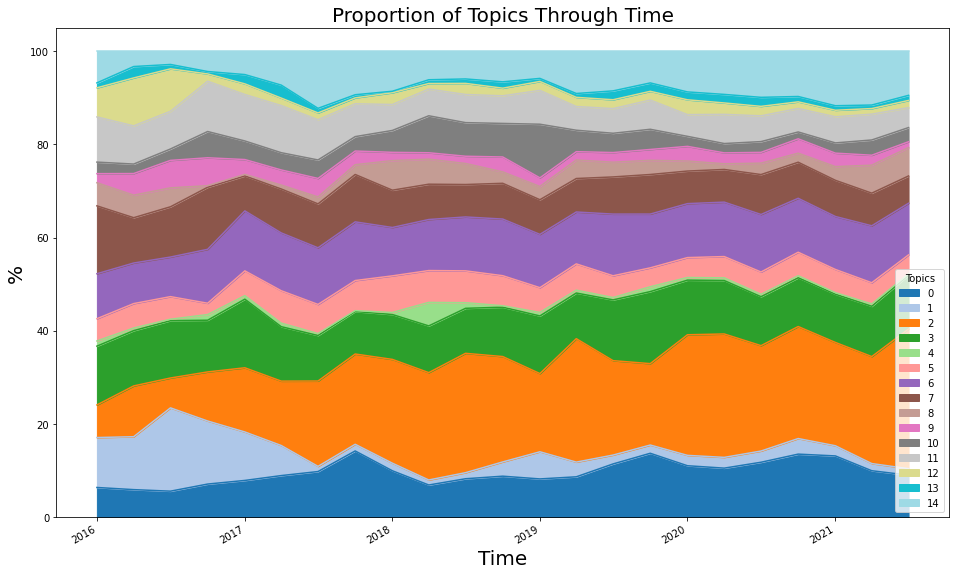

In [3]:

df['date1'] = pd.DatetimeIndex(df['date'])
df['month_year'] = df['date1'].dt.to_period( freq = 'Q')
df['year'] = pd.DatetimeIndex(df['date']).year
df_ts = df.groupby(['month_year','clusters'], as_index=True).count()
df_ts1 = df_ts[['date']]
df_ts2 = df_ts1.groupby(level=0).apply(lambda x: 100 * x / float(x.sum()))
df_ts3 = df_ts2.pivot_table(index=["month_year"], 
                    columns='clusters', 
                    values='date')
#columns = ["app ride", "moto mirror", "button bit", "battery work", "bike break", "time case", "helmet scooter"]
# df_ts3.columns = columns
#df_ts3.index= pd.to_datetime(df_ts3.index,format='%Y')
sev = df_ts3.plot.area(figsize=(16,10), use_index=True,x_compat=True, colormap="tab20")


plt.title('Proportion of Topics Through Time', fontsize=20)
plt.xlabel('Time', fontsize=20)
plt.ylabel('%', fontsize=20)
legend = plt.legend(title="Topics")
sev.figure.savefig(f'{results_folder}/07 - Topics over time.png')



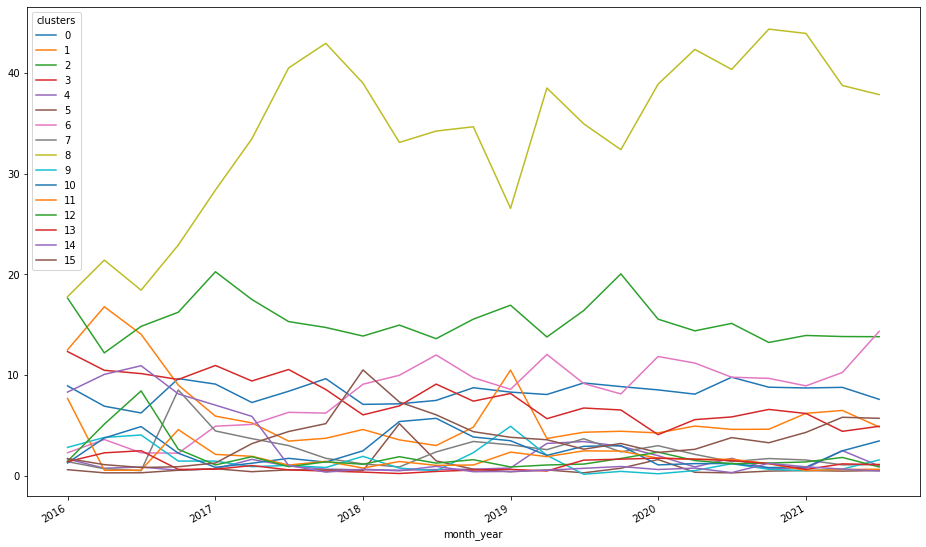

In [8]:
seva = df_ts3.plot(figsize=(16,10), use_index=True,x_compat=True)
seva.figure.savefig(f'{results_folder}/07a - Topics over time.png')

# Build co occurence matrix for analysis

In [29]:
df['text1'][df.text.str.contains('dont')]

10       the game is changing. everything is coming down into place. most of the money will be held by 3 ...
24       friend hows your #alts doing? me i dont know? is up? expressionless_face #truthhurts # #lun #trx...
110                      #eos will be the first to surpass in marketcap for a short period of time. #dont@me
285      bullseye 2| and i got india showing up for the 1st time. like i wants to get my uk numbers back ...
907      just got an email saying that this guy got a video of my porn and if i dont give him 700 dollars...
                                                        ...                                                 
15001    so as mentioned; be prepared for that explosion. im not sure how theyre going to play it out. i ...
15227    if the giveaway dont get 50 like or retweet by tommorw im gona change it to or free datdrop battles
15297    my stock just made me .00 who wants to hit up the dollar menu with me cause im ricchhh jkjk. mcd...
15324    buy signal

In [420]:
# sklearn countvectorizer
from sklearn.feature_extraction.text import CountVectorizer
# Convert a collection of text documents to a matrix of token counts
cv = CountVectorizer(ngram_range=(1,2),
                     stop_words = 'english',
                     strip_accents='unicode', max_df = 0.95, min_df = 0.01, max_features = 30)
# matrix of token counts
X = cv.fit_transform(df['text5'])
Xc = (X.T * X) # matrix manipulation
Xc.setdiag(0) # set the diagonals to be zeroes as it's pointless to be 1

In [421]:
import pandas as pd
names = cv.get_feature_names() # This are the entity names (i.e. keywords)
df10 = pd.DataFrame(data = Xc.toarray(), columns = names, index = names)
df10.to_csv(f'{results_folder}/to gephi.csv', sep = ',')

In [422]:
df10

,alt,blockchain,buy,come,currency,day,dont,eth,ethereum,face,...,new,nt,people,say,sell,think,time,use,want,year
alt,0,323,470,179,929,156,218,426,291,282,...,167,130,183,97,174,202,379,127,119,107
blockchain,323,0,146,144,1278,103,158,687,965,150,...,230,79,179,88,49,116,162,262,83,95
buy,470,146,0,219,549,312,777,357,273,854,...,277,374,615,355,920,378,655,348,423,407
come,179,144,219,0,224,155,164,131,116,311,...,168,115,165,121,76,148,215,69,78,136
currency,929,1278,549,224,0,298,345,816,1356,451,...,376,206,457,226,191,322,475,420,145,238
day,156,103,312,155,298,0,155,133,111,322,...,130,133,152,118,99,162,219,84,104,136
dont,218,158,777,164,345,155,0,199,149,464,...,148,223,451,244,210,377,295,242,407,139
eth,426,687,357,131,816,133,199,0,689,253,...,154,86,141,88,135,139,203,156,83,106
ethereum,291,965,273,116,1356,111,149,689,0,151,...,146,110,123,86,82,108,183,149,83,97
face,282,150,854,311,451,322,464,253,151,0,...,256,253,361,494,264,430,378,211,380,249


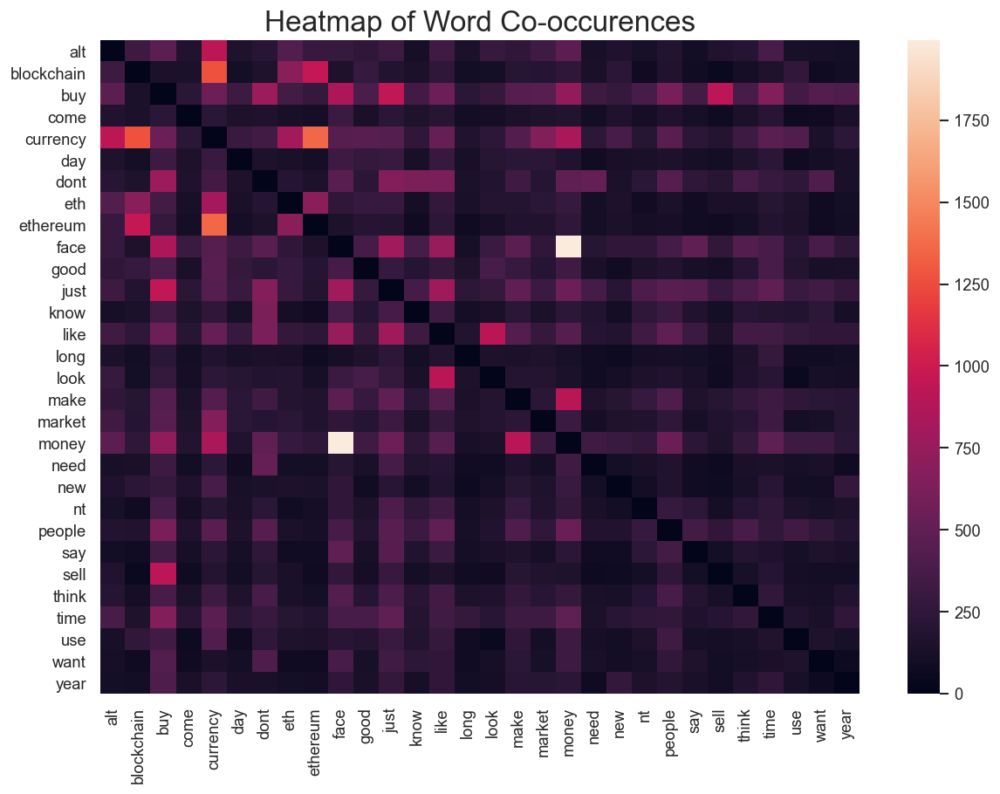

In [547]:
import numpy as np; np.random.seed(0)
import seaborn as sns; sns.set_theme()
sns.set(rc={'figure.figsize':(11.7,8.27)}, font_scale=1.0)
plt.title('Heatmap of Word Co-occurences', fontsize = 20) # title with fontsize 20
ax = sns.heatmap(df10)
figure = ax.get_figure()    
figure.savefig('09 - heatmap.png', dpi=400)

# output topics and terms

In [4]:
df_tf

NameError: name 'df_tf' is not defined

In [427]:
df_tf2 = df_tf.groupby(['Topic'])['Term'].apply(lambda text: ''.join(text.to_string(index=False))).str.replace('(\\n)', ',').reset_index()

In [428]:
df_tf2

,Topic,Term
0,Topic 0,"year, buy, invest, make, money, ..."
1,Topic 1,"face.with.tears.of.joy, play, ..."
2,Topic 10,"blockchain, ethereum, currency, project, ico, eth, token, great, te..."
3,Topic 11,"wallet, exchange, send, pay, accept, account, ..., cash,..."
4,Topic 12,"term, long, future, short, marine, tweet, etf, lo..."
5,Topic 13,"fee, rate, ..."
6,Topic 14,"buy, rocket, sell, ..., wait, dip, fir..."
7,Topic 2,"..., market, time, week, move, close, long, high, break, back, pump, bull,..."
8,Topic 3,"currency, money, world, bank, digital, network, fiat, asset,..."
9,Topic 4,"number, rt, news, ..."


In [429]:
df_tf2.to_csv(f'{results_folder}/08 - Topics.csv')

# get alpha

In [303]:
model2.alpha

array([0.44228789, 0.07556672, 0.08963518, 0.01258657, 0.01730306,
       0.09082336, 0.0172242 , 0.02524561, 0.14521428, 0.01810905,
       0.0314266 , 0.1109949 , 0.01643892, 0.48027276, 0.00505746,
       0.0120775 , 0.03205125, 0.1709487 ])

# Var stuff

In [5]:
import pandas as pd
from datetime import datetime
import matplotlib.pyplot as plt
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.api import VAR
from scipy.stats import pearsonr

In [6]:
def parser(s):
    return datetime.strptime(s, '%Y-%m-%d')

In [7]:
btc_price_df = pd.read_csv('data/BTC_USD_2013-10-01_2021-08-18-CoinDesk.csv', parse_dates=[1],  squeeze=True, date_parser=parser, index_col=1)

In [8]:
btc_price_df['BTC Price'] = btc_price_df['Closing Price (USD)']
btc_price_df['Date'] = btc_price_df.index
btc_price_df['Date1'] = pd.to_datetime(btc_price_df['Date']).dt.date
btc_price_df


,Currency,Closing Price (USD),24h Open (USD),24h High (USD),24h Low (USD),BTC Price,Date,Date1
Date,,,,,,,,
2013-10-01,BTC,123.654990,124.304660,124.751660,122.563490,123.654990,2013-10-01,2013-10-01
2013-10-02,BTC,125.455000,123.654990,125.758500,123.633830,125.455000,2013-10-02,2013-10-02
2013-10-03,BTC,108.584830,125.455000,125.665660,83.328330,108.584830,2013-10-03,2013-10-03
2013-10-04,BTC,118.674660,108.584830,118.675000,107.058160,118.674660,2013-10-04,2013-10-04
2013-10-05,BTC,121.338660,118.674660,121.936330,118.005660,121.338660,2013-10-05,2013-10-05
...,...,...,...,...,...,...,...,...
2021-08-14,BTC,47654.729022,44433.880228,47861.031980,44264.697085,47654.729022,2021-08-14,2021-08-14
2021-08-15,BTC,47004.357461,47810.373711,48126.473768,46063.802197,47004.357461,2021-08-15,2021-08-15
2021-08-16,BTC,47144.842567,47099.469780,47370.906853,45619.599550,47144.842567,2021-08-16,2021-08-16


In [9]:
btc_price_df2 = btc_price_df.asfreq(pd.infer_freq(btc_price_df.index))
btc_price_df2

,Currency,Closing Price (USD),24h Open (USD),24h High (USD),24h Low (USD),BTC Price,Date,Date1
Date,,,,,,,,
2013-10-01,BTC,123.654990,124.304660,124.751660,122.563490,123.654990,2013-10-01,2013-10-01
2013-10-02,BTC,125.455000,123.654990,125.758500,123.633830,125.455000,2013-10-02,2013-10-02
2013-10-03,BTC,108.584830,125.455000,125.665660,83.328330,108.584830,2013-10-03,2013-10-03
2013-10-04,BTC,118.674660,108.584830,118.675000,107.058160,118.674660,2013-10-04,2013-10-04
2013-10-05,BTC,121.338660,118.674660,121.936330,118.005660,121.338660,2013-10-05,2013-10-05
...,...,...,...,...,...,...,...,...
2021-08-14,BTC,47654.729022,44433.880228,47861.031980,44264.697085,47654.729022,2021-08-14,2021-08-14
2021-08-15,BTC,47004.357461,47810.373711,48126.473768,46063.802197,47004.357461,2021-08-15,2021-08-15
2021-08-16,BTC,47144.842567,47099.469780,47370.906853,45619.599550,47144.842567,2021-08-16,2021-08-16


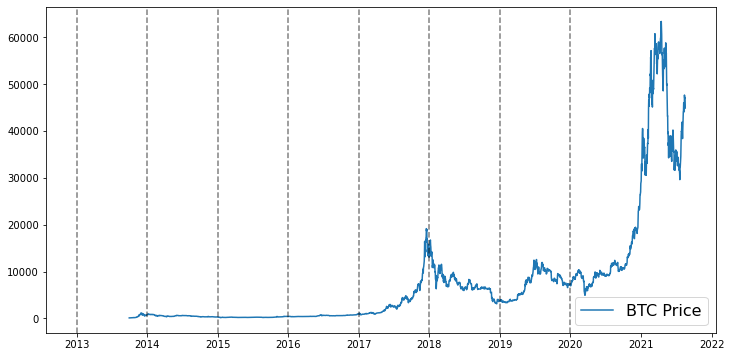

In [10]:
plt.figure(figsize=(12,6))
btc_price_df2, = plt.plot(btc_price_df2['BTC Price'])
#heater, = plt.plot(ice_cream_heater_df['heater'], color='red')

for year in range(2013, 2021):
    plt.axvline(datetime(year,1,1), linestyle='--', color='k', alpha=0.5)

plt.legend(['BTC Price'
            #, 'Heater'
           ], fontsize=16)


In [11]:
df['day_date'] = df['date1'].dt.to_period( freq = 'd')
df['date1'] = pd.to_datetime(df.date1).dt.tz_localize(None)
df['date2'] = df['date1'].dt.tz_localize(None)
df['date3'] = pd.to_datetime(df.date2)
df['date4'] = pd.to_datetime(df['date3']).dt.date
#get it by week


C:\Users\T430\anaconda3\lib\site-packages\pandas\core\arrays\datetimes.py:1101: UserWarning: Converting to PeriodArray/Index representation will drop timezone information.
  warnings.warn(


# change to a proportion of the 300

In [12]:
# def getweek(date):
#     #get weekyear
#     date = date.isocalendar()[1]
#     return date

# def getyear(date):
#     #get weekyear
#     date = date.isocalendar()[0]
#     return date
# #apply clean
# df['week'] = df['date1'].map(getweek)
# df['year2'] = df['date1'].map(getyear)

In [13]:
#df

In [14]:
# df['week_yr'] = pd.to_datetime(df['year2'].astype(str) + ' ' + df['week'].astype(str) + ' 1',
#                                 format='%Y %U %w')

In [15]:
# df['week_year2'] = df['year2'].astype(str)+"_" +df['week'].astype(str)

In [16]:
#df

In [17]:
df = df.sort_values(by="date")

In [18]:
df.date.unique()

array(['2016-01-01 23:04:44+00:00', '2016-01-01 23:04:57+00:00',
       '2016-01-01 23:06:34+00:00', ..., '2021-08-23 23:59:41+00:00',
       '2021-08-23 23:59:51+00:00', '2021-08-23 23:59:57+00:00'],
      dtype=object)

In [19]:
df2 = df.loc[df["clusters"] == 14]
df2.value_counts(["date4", "clusters"])
dfts1 = df2.groupby(by=["date4"], as_index=False).size()

In [21]:
dfts1


,date4,size
0,2016-01-07,1
1,2016-01-08,2
2,2016-01-09,1
3,2016-01-10,2
4,2016-01-13,4
...,...,...
1694,2021-08-19,7
1695,2021-08-20,11
1696,2021-08-21,10
1697,2021-08-22,3


In [22]:
#keep values only past 2016
btc_price_df
btc_price_df = btc_price_df[(btc_price_df['Date']> "2016-01-01")]

In [23]:
merged_left = pd.merge(left=dfts1[['date4', 'size']], right=btc_price_df[['BTC Price', 'Date1']], how='right', left_on = 'date4', right_on='Date1')

In [24]:
merged_left

,date4,size,BTC Price,Date1
0,NaN,NaN,433.773000,2016-01-02
1,NaN,NaN,431.985000,2016-01-03
2,NaN,NaN,431.691000,2016-01-04
3,NaN,NaN,433.732000,2016-01-05
4,NaN,NaN,427.164000,2016-01-06
...,...,...,...,...
2036,2021-08-14,6.0,47654.729022,2021-08-14
2037,2021-08-15,7.0,47004.357461,2021-08-15
2038,2021-08-16,5.0,47144.842567,2021-08-16
2039,2021-08-17,8.0,46181.730824,2021-08-17


In [25]:
merged_left['size'] = merged_left['size'].fillna(0)

In [26]:
merged_left['Date1'].is_unique

True

In [27]:
dft = merged_left[['Date1', 'BTC Price', 'size']]

In [28]:
dft

,Date1,BTC Price,size
0,2016-01-02,433.773000,0.0
1,2016-01-03,431.985000,0.0
2,2016-01-04,431.691000,0.0
3,2016-01-05,433.732000,0.0
4,2016-01-06,427.164000,0.0
...,...,...,...
2036,2021-08-14,47654.729022,6.0
2037,2021-08-15,47004.357461,7.0
2038,2021-08-16,47144.842567,5.0
2039,2021-08-17,46181.730824,8.0


In [29]:
#duplicates
merged_left[merged_left.duplicated(['Date1'], keep=False)]

,date4,size,BTC Price,Date1


In [30]:
dft = dft.bfill()
dft[dft.isna().any(axis=1)]
dft1 = dft
dft1['datetest'] = dft.index
dft['size2'] = dft['size']*5000

In [31]:
dft

,Date1,BTC Price,size,datetest,size2
0,2016-01-02,433.773000,0.0,0,0.0
1,2016-01-03,431.985000,0.0,1,0.0
2,2016-01-04,431.691000,0.0,2,0.0
3,2016-01-05,433.732000,0.0,3,0.0
4,2016-01-06,427.164000,0.0,4,0.0
...,...,...,...,...,...
2036,2021-08-14,47654.729022,6.0,2036,30000.0
2037,2021-08-15,47004.357461,7.0,2037,35000.0
2038,2021-08-16,47144.842567,5.0,2038,25000.0
2039,2021-08-17,46181.730824,8.0,2039,40000.0


In [32]:
dft = dft.set_index('Date1')

In [33]:
dft

,BTC Price,size,datetest,size2
Date1,,,,
2016-01-02,433.773000,0.0,0,0.0
2016-01-03,431.985000,0.0,1,0.0
2016-01-04,431.691000,0.0,2,0.0
2016-01-05,433.732000,0.0,3,0.0
2016-01-06,427.164000,0.0,4,0.0
...,...,...,...,...
2021-08-14,47654.729022,6.0,2036,30000.0
2021-08-15,47004.357461,7.0,2037,35000.0
2021-08-16,47144.842567,5.0,2038,25000.0


NameError: name 'results_folder' is not defined

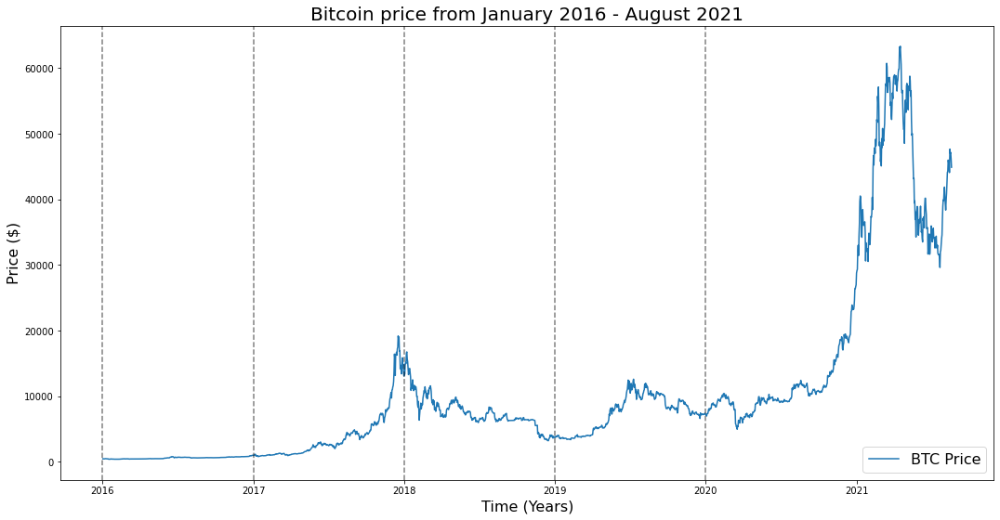

In [34]:
plt.figure(figsize=(18,9))
BTCprice, = plt.plot(dft['BTC Price'])
#size, = plt.plot(dft['size2'], color='red')

for year in range(2016, 2021):
    plt.axvline(datetime(year,1,1), linestyle='--', color='k', alpha=0.5)
plt.title("Bitcoin price from January 2016 - August 2021", fontsize = 20)
plt.xlabel('Time (Years)', fontsize=16)
plt.ylabel('Price ($)', fontsize=16)
plt.legend(['BTC Price'], fontsize=16)
plt.savefig(f'{results_folder}/08 - BTC Price.png')

In [96]:
dft

,BTC Price,size,datetest,size2
Date1,,,,
2016-01-02,433.773000,0.0,0,0.0
2016-01-03,431.985000,0.0,1,0.0
2016-01-04,431.691000,0.0,2,0.0
2016-01-05,433.732000,0.0,3,0.0
2016-01-06,427.164000,0.0,4,0.0
...,...,...,...,...
2021-08-14,47654.729022,6.0,2036,30000.0
2021-08-15,47004.357461,7.0,2037,35000.0
2021-08-16,47144.842567,5.0,2038,25000.0


NameError: name 'results_folder' is not defined

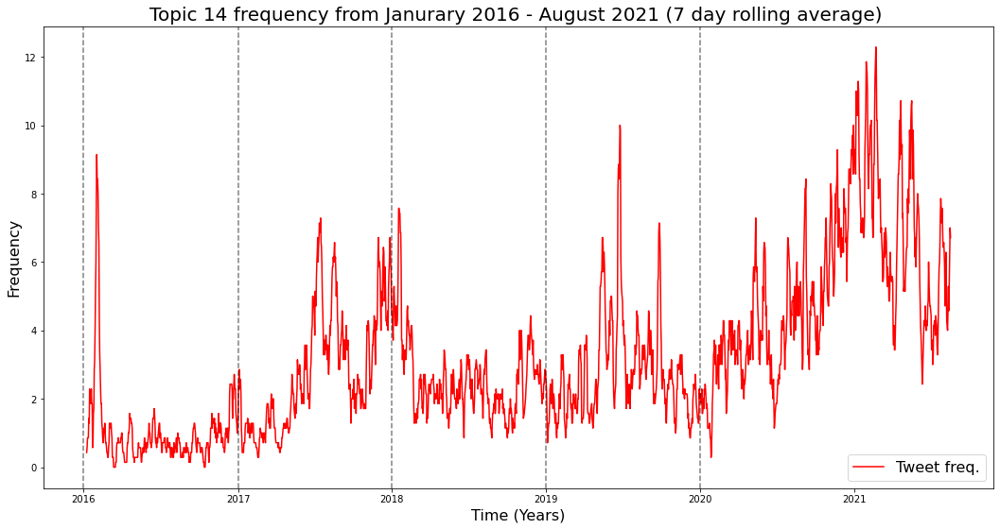

In [35]:
# do rolling average of the normalised data
dft['rollavg_size'] = dft['size'].rolling(7).mean()
plt.figure(figsize=(18,9))
BTCprice, = plt.plot(dft['rollavg_size'], color='red')
#size, = plt.plot(dft['size2'], color='red')

for year in range(2016, 2021):
    plt.axvline(datetime(year,1,1), linestyle='--', color='k', alpha=0.5)
plt.title("Topic 14 frequency from Janurary 2016 - August 2021 (7 day rolling average) ", fontsize = 20)
plt.xlabel('Time (Years)', fontsize=16)
plt.ylabel('Frequency', fontsize=16)
plt.legend(['Tweet freq.'], fontsize=16)
plt.savefig(f'{results_folder}/09 - Topic tweet frequency.png')

# normalise

In [47]:
dft1 = dft[['BTC Price', 'size']]
avgs = dft1.mean()
devs = dft1.std()
for col in dft1.columns:
    dft1[col] = (dft1[col] - avgs.loc[col]) / devs.loc[col]

<ipython-input-47-8ce1f9001875>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dft1[col] = (dft1[col] - avgs.loc[col]) / devs.loc[col]


In [99]:

dft1

,BTC Price,size
Date1,,
2016-01-02,-0.752948,-0.995917
2016-01-03,-0.753083,-0.995917
2016-01-04,-0.753105,-0.995917
2016-01-05,-0.752951,-0.995917
2016-01-06,-0.753448,-0.995917
...,...,...
2021-08-14,2.819815,0.881546
2021-08-15,2.770608,1.194456
2021-08-16,2.781237,0.568635


<ipython-input-50-09f8532fc6b8>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dft1['rollavg_size'] = dft1['size'].rolling(7).mean()


NameError: name 'results_folder' is not defined

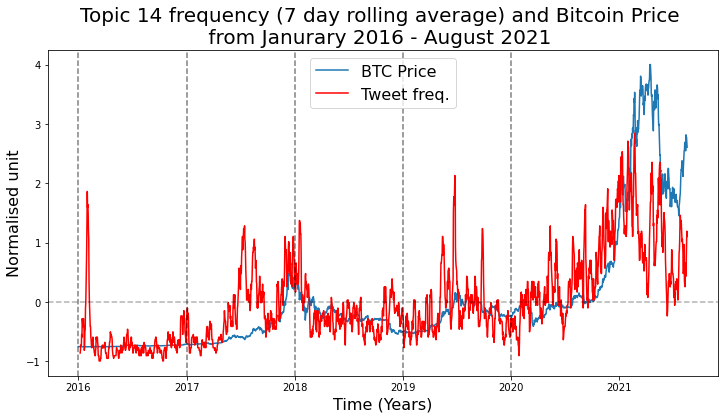

In [50]:
# do rolling average of the normalised data
dft1['rollavg_size'] = dft1['size'].rolling(7).mean()
plt.figure(figsize=(12,6))
BTCPrice, = plt.plot(dft1['BTC Price'])
size, = plt.plot(dft1['rollavg_size'], color='red')

for year in range(2016, 2021):
    plt.axvline(datetime(year,1,1), linestyle='--', color='k', alpha=0.5)
    
plt.axhline(0, linestyle='--', color='k', alpha=0.3)
plt.title("Topic 14 frequency (7 day rolling average) and Bitcoin Price \n from Janurary 2016 - August 2021  ", fontsize = 20)
plt.xlabel('Time (Years)', fontsize=16)
plt.ylabel('Normalised unit', fontsize=16)
plt.legend(['BTC Price','Tweet freq.'], fontsize=16)
plt.savefig(f'{results_folder}/09 - Topic tweet frequency.png')

# take first difference to remove trend

In [369]:
dft1 = dft1.diff().dropna()


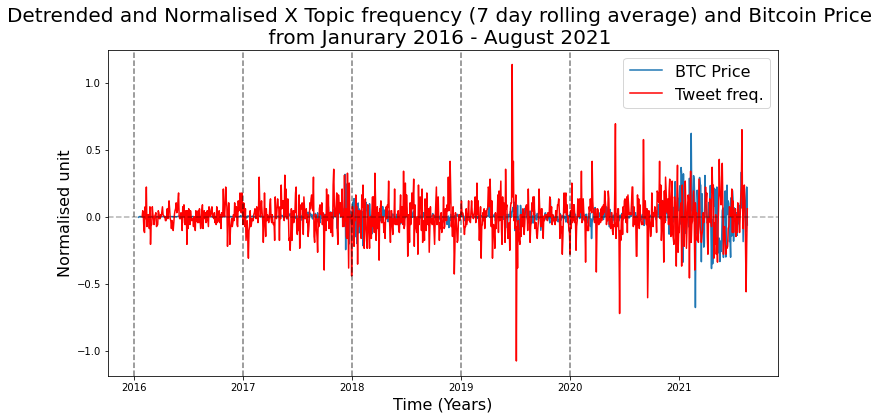

In [370]:
dft1['rollavg_size'] = dft1['size'].rolling(7).mean()
plt.figure(figsize=(12,6))
BTCPrice, = plt.plot(dft1['BTC Price'])
size, = plt.plot(dft1['rollavg_size'], color='red')

for year in range(2016, 2021):
    plt.axvline(datetime(year,1,1), linestyle='--', color='k', alpha=0.5)
    
plt.axhline(0, linestyle='--', color='k', alpha=0.3)
plt.title("Detrended and Normalised X Topic frequency (7 day rolling average) and Bitcoin Price \n from Janurary 2016 - August 2021  ", fontsize = 20)
plt.xlabel('Time (Years)', fontsize=16)
plt.ylabel('Normalised unit', fontsize=16)
plt.legend(['BTC Price','Tweet freq.'], fontsize=16)
plt.savefig(f'{results_folder}/10 - Normalised.png')

# remove increasing volatility 

In [371]:
dft1.index = pd.to_datetime(dft1.index)
annual_volatility = dft1.groupby(dft1.index.year).std()
dft1['BTC_annual_vol'] = dft1.index.map(lambda d: annual_volatility.loc[d.year, 'BTC Price'])
dft1['size_annual_vol'] = dft1.index.map(lambda d: annual_volatility.loc[d.year, 'size'])

In [372]:
dft1['BTC Price'] = dft1['BTC Price'] / dft1['BTC_annual_vol']
dft1['size'] = dft1['size'] / dft1['size_annual_vol']

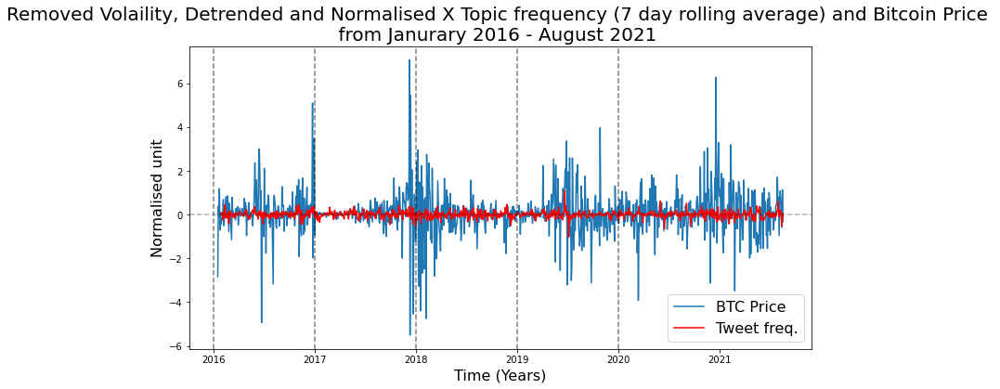

In [373]:
dft1['rollavg_size'] = dft1['size'].rolling(7).mean()
plt.figure(figsize=(12,6))
BTCPrice, = plt.plot(dft1['BTC Price'])
size, = plt.plot(dft1['rollavg_size'], color='red')

for year in range(2016, 2021):
    plt.axvline(datetime(year,1,1), linestyle='--', color='k', alpha=0.5)
    
plt.axhline(0, linestyle='--', color='k', alpha=0.3)
plt.title("Removed Volaility, Detrended and Normalised X Topic frequency (7 day rolling average) and Bitcoin Price \n from Janurary 2016 - August 2021  ", fontsize = 20)
plt.xlabel('Time (Years)', fontsize=16)
plt.ylabel('Normalised unit', fontsize=16)
plt.legend(['BTC Price','Tweet freq.'], fontsize=16)
plt.savefig(f'{results_folder}/11 - Removed Volatility.png')

# Remove seasonality

In [374]:
month_avgs = dft1.groupby(dft1.index.month).mean()
dft1['BTC_month_avg'] = dft1.index.map(lambda d: month_avgs.loc[d.month, 'BTC Price'])
dft1['size_month_avg'] = dft1.index.map(lambda d: month_avgs.loc[d.month, 'size'])
dft1['BTC Price'] = dft1['BTC Price'] - dft1['BTC_month_avg']
dft1['size'] = dft1['size'] - dft1['size_month_avg']

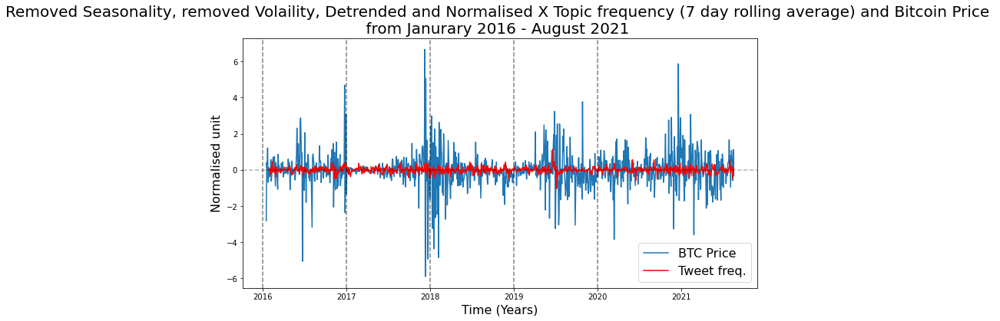

In [375]:
dft1['rollavg_size'] = dft1['size'].rolling(7).mean()
plt.figure(figsize=(12,6))
BTCPrice, = plt.plot(dft1['BTC Price'])
size, = plt.plot(dft1['rollavg_size'], color='red')

for year in range(2016, 2021):
    plt.axvline(datetime(year,1,1), linestyle='--', color='k', alpha=0.5)
    
plt.axhline(0, linestyle='--', color='k', alpha=0.3)
plt.title("Removed Seasonality, removed Volaility, Detrended and Normalised X Topic frequency (7 day rolling average) and Bitcoin Price \n from Janurary 2016 - August 2021  ", fontsize = 20)
plt.xlabel('Time (Years)', fontsize=16)
plt.ylabel('Normalised unit', fontsize=16)
plt.legend(['BTC Price','Tweet freq.'], fontsize=16)
plt.savefig(f'{results_folder}/12 - Remove seasonality.png')

# VAr Model

In [380]:
dft1

,BTC Price,size,rollavg_size,BTC_annual_vol,size_annual_vol,BTC_month_avg,size_month_avg
date4,,,,,,,
2016-01-16,-2.811082,1.451612,NaN,0.001563,0.494710,-0.031107,0.009386
2016-01-18,0.422512,-0.426814,NaN,0.001563,0.494710,-0.031107,0.009386
2016-01-20,-0.067810,0.616756,NaN,0.001563,0.494710,-0.031107,0.009386
2016-01-22,1.217723,0.199328,NaN,0.001563,0.494710,-0.031107,0.009386
2016-01-24,-0.682577,-1.470384,NaN,0.001563,0.494710,-0.031107,0.009386
...,...,...,...,...,...,...,...
2021-08-09,0.652781,0.428730,0.126499,0.194843,1.079023,0.002142,-0.045965
2021-08-11,0.496144,-1.485093,-0.173501,0.194843,1.079023,0.002142,-0.045965
2021-08-13,-0.584168,0.715803,-0.473501,0.194843,1.079023,0.002142,-0.045965


In [378]:
dft1.index = pd.DatetimeIndex(dft1.index).to_period('d')
dft1

,BTC Price,size,rollavg_size,BTC_annual_vol,size_annual_vol,BTC_month_avg,size_month_avg
date4,,,,,,,
2016-01-16,-2.811082,1.451612,NaN,0.001563,0.494710,-0.031107,0.009386
2016-01-18,0.422512,-0.426814,NaN,0.001563,0.494710,-0.031107,0.009386
2016-01-20,-0.067810,0.616756,NaN,0.001563,0.494710,-0.031107,0.009386
2016-01-22,1.217723,0.199328,NaN,0.001563,0.494710,-0.031107,0.009386
2016-01-24,-0.682577,-1.470384,NaN,0.001563,0.494710,-0.031107,0.009386
...,...,...,...,...,...,...,...
2021-08-09,0.652781,0.428730,0.126499,0.194843,1.079023,0.002142,-0.045965
2021-08-11,0.496144,-1.485093,-0.173501,0.194843,1.079023,0.002142,-0.045965
2021-08-13,-0.584168,0.715803,-0.473501,0.194843,1.079023,0.002142,-0.045965


In [379]:
dft1var = dft1[['BTC Price', 'size']]
model = VAR(dft1var)
model_fit = model.fit(maxlags=30)
model_fit.summary()
# look at btc price, and those that are significant are the ones that impact btc price 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Thu, 16, Sep, 2021
Time:                     19:14:33
--------------------------------------------------------------------
No. of Equations:         2.00000    BIC:                   0.165901
Nobs:                     986.000    HQIC:                 -0.209312
Log likelihood:          -2459.42    FPE:                   0.644496
AIC:                    -0.439602    Det(Omega_mle):        0.571585
--------------------------------------------------------------------
Results for equation BTC Price
                   coefficient       std. error           t-stat            prob
--------------------------------------------------------------------------------
const                 0.004129         0.031013            0.133           0.894
L1.BTC Price         -0.028518         0.032850           -0.868           0.385
L1.size               0.219862         0.041169         

#  PACF 

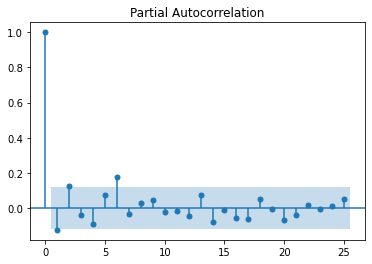

In [246]:
plot_pacf(dft1['BTC Price'])
plt.show()

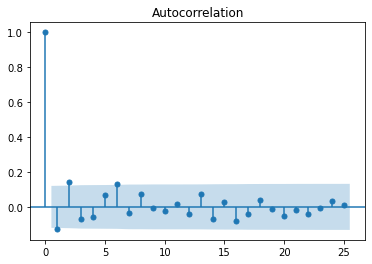

In [152]:
plot_acf(dft1['BTC Price'])
plt.show()

In [153]:
dft1

,BTC Price,size,rollavg_size,BTC_annual_vol,size2_annual_vol,size_annual_vol,BTC_month_avg,size_month_avg
date4,,,,,,,,
2016-03-08,-0.266327,0.155271,0.000000e+00,1.0,1.758793,1.758793,-0.120631,-0.155271
2016-04-01,-0.075576,0.033682,-5.551115e-17,1.0,1.758793,1.758793,0.110756,-0.033682
2016-04-05,0.007201,0.033682,5.551115e-17,1.0,1.758793,1.758793,0.110756,-0.033682
2016-04-21,0.313865,0.033682,-5.551115e-17,1.0,1.758793,1.758793,0.110756,-0.033682
2016-04-25,0.179991,0.033682,5.551115e-17,1.0,1.758793,1.758793,0.110756,-0.033682
...,...,...,...,...,...,...,...,...
2021-07-12,-0.073915,-0.955058,0.000000e+00,1.0,1.748300,1.748300,0.163221,-0.107398
2021-07-20,-0.955605,0.107398,-2.653560e-01,1.0,1.748300,1.748300,0.163221,-0.107398
2021-07-26,0.673363,0.107398,0.000000e+00,1.0,1.748300,1.748300,0.163221,-0.107398


In [248]:
for lag in range(1, 30):
    heater_series = dft1['BTC Price'].iloc[lag:]
    lagged_ice_cream_series = dft1['size'].iloc[:-lag]
    print('Lag: %s'%lag)
    print(pearsonr(heater_series, lagged_ice_cream_series))
    print('------')

Lag: 1
(0.02302010220529156, 0.7091350005852596)
------
Lag: 2
(-0.060393613601188195, 0.32831362172846285)
------
Lag: 3
(0.08590376947510737, 0.16481506416186498)
------
Lag: 4
(-0.07024691426444471, 0.257210447423236)
------
Lag: 5
(0.02398381741135231, 0.699743964322636)
------
Lag: 6
(-0.009192786860056229, 0.8827230714044042)
------
Lag: 7
(0.0009516571685305414, 0.9878395970435884)
------
Lag: 8
(-0.05786206519925364, 0.35462000403889665)
------
Lag: 9
(0.06494763268452237, 0.2996381266621653)
------
Lag: 10
(-0.00010616153621425747, 0.9986513587020618)
------
Lag: 11
(-0.06745408593311955, 0.2832325673134705)
------
Lag: 12
(-0.018821118418094737, 0.7653168583923372)
------
Lag: 13
(0.05343985068377855, 0.39732483645059014)
------
Lag: 14
(-0.03145171965237433, 0.6192445693458812)
------
Lag: 15
(0.025301209217545598, 0.6899598347132545)
------
Lag: 16
(-0.012748913683444402, 0.8410301571519145)
------
Lag: 17
(0.028436238682791694, 0.6552008801049463)
------
Lag: 18
(-0.154099

In [5]:
from pandas import read_csv
from matplotlib import pyplot
from statsmodels.tsa.seasonal import seasonal_decompose
#series = read_csv('airline-passengers.csv', header=0, index_col=0)


In [33]:
btc_price_df2

,Currency,Closing Price (USD),24h Open (USD),24h High (USD),24h Low (USD),BTC Price,Date,Date1
Date,,,,,,,,
2013-10-01,BTC,123.654990,124.304660,124.751660,122.563490,123.654990,2013-10-01,2013-10-01
2013-10-02,BTC,125.455000,123.654990,125.758500,123.633830,125.455000,2013-10-02,2013-10-02
2013-10-03,BTC,108.584830,125.455000,125.665660,83.328330,108.584830,2013-10-03,2013-10-03
2013-10-04,BTC,118.674660,108.584830,118.675000,107.058160,118.674660,2013-10-04,2013-10-04
2013-10-05,BTC,121.338660,118.674660,121.936330,118.005660,121.338660,2013-10-05,2013-10-05
...,...,...,...,...,...,...,...,...
2021-08-14,BTC,47654.729022,44433.880228,47861.031980,44264.697085,47654.729022,2021-08-14,2021-08-14
2021-08-15,BTC,47004.357461,47810.373711,48126.473768,46063.802197,47004.357461,2021-08-15,2021-08-15
2021-08-16,BTC,47144.842567,47099.469780,47370.906853,45619.599550,47144.842567,2021-08-16,2021-08-16


In [43]:
btc_price_df2 = btc_price_df.asfreq(pd.infer_freq(btc_price_df.index))
btc_price_df2
btc_price_df2 = btc_price_df2.fillna(method='bfill').fillna(method='ffill')

In [44]:
btc_price_df2

,Currency,Closing Price (USD),24h Open (USD),24h High (USD),24h Low (USD),BTC Price,Date,Date1
Date,,,,,,,,
2013-10-01,BTC,123.654990,124.304660,124.751660,122.563490,123.654990,2013-10-01,2013-10-01
2013-10-02,BTC,125.455000,123.654990,125.758500,123.633830,125.455000,2013-10-02,2013-10-02
2013-10-03,BTC,108.584830,125.455000,125.665660,83.328330,108.584830,2013-10-03,2013-10-03
2013-10-04,BTC,118.674660,108.584830,118.675000,107.058160,118.674660,2013-10-04,2013-10-04
2013-10-05,BTC,121.338660,118.674660,121.936330,118.005660,121.338660,2013-10-05,2013-10-05
...,...,...,...,...,...,...,...,...
2021-08-14,BTC,47654.729022,44433.880228,47861.031980,44264.697085,47654.729022,2021-08-14,2021-08-14
2021-08-15,BTC,47004.357461,47810.373711,48126.473768,46063.802197,47004.357461,2021-08-15,2021-08-15
2021-08-16,BTC,47144.842567,47099.469780,47370.906853,45619.599550,47144.842567,2021-08-16,2021-08-16


<ipython-input-45-1448fd842f20>:1: FutureWarning: the 'freq'' keyword is deprecated, use 'period' instead
  result = seasonal_decompose(btc_price_df2['BTC Price'], freq=365)


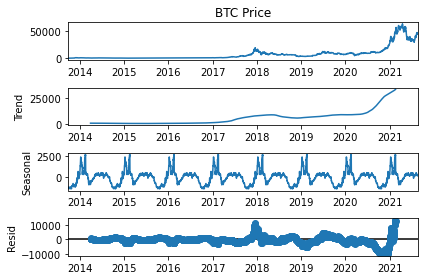

In [45]:
result = seasonal_decompose(btc_price_df2['BTC Price'], freq=365)
result.plot()
pyplot.show()

In [39]:
btc_price_df2['BTC Price']

Date
2013-10-01      123.654990
2013-10-02      125.455000
2013-10-03      108.584830
2013-10-04      118.674660
2013-10-05      121.338660
                  ...     
2021-08-14    47654.729022
2021-08-15    47004.357461
2021-08-16    47144.842567
2021-08-17    46181.730824
2021-08-18    44887.242787
Freq: D, Name: BTC Price, Length: 2879, dtype: float64

# Start the time series stuff
From https://www.machinelearningplus.com/time-series/vector-autoregression-examples-python/

In [9]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

# Import Statsmodels
from statsmodels.tsa.api import VAR
from statsmodels.tsa.stattools import adfuller
from statsmodels.tools.eval_measures import rmse, aic

In [58]:
dft

,BTC Price,size,datetest,size2,rollavg_size
date4,,,,,
2016-01-01,432.358,3,0,15000,NaN
2016-01-02,433.773,1,1,5000,NaN
2016-01-03,431.985,5,2,25000,NaN
2016-01-04,431.691,5,3,25000,NaN
2016-01-05,433.732,5,4,25000,NaN
...,...,...,...,...,...
2021-08-19,NaN,25,2044,125000,24.285714
2021-08-20,NaN,45,2045,225000,25.428571
2021-08-21,NaN,18,2046,90000,25.285714


In [60]:
dft1 = dft[['BTC Price', 'size']]

In [61]:
dft1

,BTC Price,size
date4,,
2016-01-01,432.358,3
2016-01-02,433.773,1
2016-01-03,431.985,5
2016-01-04,431.691,5
2016-01-05,433.732,5
...,...,...
2021-08-19,NaN,25
2021-08-20,NaN,45
2021-08-21,NaN,18


In [69]:
dft1 = dft1.dropna()

In [70]:
dft1

,BTC Price,size
date4,,
2016-01-01,432.358000,3
2016-01-02,433.773000,1
2016-01-03,431.985000,5
2016-01-04,431.691000,5
2016-01-05,433.732000,5
...,...,...
2021-08-14,47654.729022,19
2021-08-15,47004.357461,22
2021-08-16,47144.842567,26


In [72]:
from statsmodels.tsa.stattools import grangercausalitytests
maxlag=30
test = 'ssr_chi2test'
def grangers_causation_matrix(data, variables, test='ssr_chi2test', verbose=False):    
    """Check Granger Causality of all possible combinations of the Time series.
    The rows are the response variable, columns are predictors. The values in the table 
    are the P-Values. P-Values lesser than the significance level (0.05), implies 
    the Null Hypothesis that the coefficients of the corresponding past values is 
    zero, that is, the X does not cause Y can be rejected.

    data      : pandas dataframe containing the time series variables
    variables : list containing names of the time series variables.
    """
    df = pd.DataFrame(np.zeros((len(variables), len(variables))), columns=variables, index=variables)
    for c in df.columns:
        for r in df.index:
            test_result = grangercausalitytests(data[[r, c]], maxlag=maxlag, verbose=False)
            p_values = [round(test_result[i+1][0][test][1],4) for i in range(maxlag)]
            if verbose: print(f'Y = {r}, X = {c}, P Values = {p_values}')
            min_p_value = np.min(p_values)
            df.loc[r, c] = min_p_value
    df.columns = [var + '_x' for var in variables]
    df.index = [var + '_y' for var in variables]
    return df

grangers_causation_matrix(dft1, variables = dft1.columns)   

,BTC Price_x,size_x
BTC Price_y,1.0,0.0
size_y,0.0,1.0


In [73]:
from statsmodels.tsa.vector_ar.vecm import coint_johansen

def cointegration_test(df, alpha=0.05): 
    """Perform Johanson's Cointegration Test and Report Summary"""
    out = coint_johansen(df,-1,5)
    d = {'0.90':0, '0.95':1, '0.99':2}
    traces = out.lr1
    cvts = out.cvt[:, d[str(1-alpha)]]
    def adjust(val, length= 6): return str(val).ljust(length)

    # Summary
    print('Name   ::  Test Stat > C(95%)    =>   Signif  \n', '--'*20)
    for col, trace, cvt in zip(df.columns, traces, cvts):
        print(adjust(col), ':: ', adjust(round(trace,2), 9), ">", adjust(cvt, 8), ' =>  ' , trace > cvt)

cointegration_test(dft1)

Name   ::  Test Stat > C(95%)    =>   Signif  
 ----------------------------------------
BTC Price ::  32.01     > 12.3212   =>   True
size   ::  0.15      > 4.1296    =>   False


In [76]:
dft1

,BTC Price,size
date4,,
2016-01-01,432.358000,3
2016-01-02,433.773000,1
2016-01-03,431.985000,5
2016-01-04,431.691000,5
2016-01-05,433.732000,5
...,...,...
2021-08-14,47654.729022,19
2021-08-15,47004.357461,22
2021-08-16,47144.842567,26


In [98]:
nobs =  365
dft1_train, dft1_test = dft1[0:-nobs], dft1[-nobs:]

# Check size
print(dft1_train.shape)  # (119, 8)
print(dft1_test.shape)  # (4, 8)

(1679, 2)
(365, 2)


In [99]:
def adfuller_test(series, signif=0.05, name='', verbose=False):
    """Perform ADFuller to test for Stationarity of given series and print report"""
    r = adfuller(series, autolag='AIC')
    output = {'test_statistic':round(r[0], 4), 'pvalue':round(r[1], 4), 'n_lags':round(r[2], 4), 'n_obs':r[3]}
    p_value = output['pvalue'] 
    def adjust(val, length= 6): return str(val).ljust(length)

    # Print Summary
    print(f'    Augmented Dickey-Fuller Test on "{name}"', "\n   ", '-'*47)
    print(f' Null Hypothesis: Data has unit root. Non-Stationary.')
    print(f' Significance Level    = {signif}')
    print(f' Test Statistic        = {output["test_statistic"]}')
    print(f' No. Lags Chosen       = {output["n_lags"]}')

    for key,val in r[4].items():
        print(f' Critical value {adjust(key)} = {round(val, 3)}')

    if p_value <= signif:
        print(f" => P-Value = {p_value}. Rejecting Null Hypothesis.")
        print(f" => Series is Stationary.")
    else:
        print(f" => P-Value = {p_value}. Weak evidence to reject the Null Hypothesis.")
        print(f" => Series is Non-Stationary.")    

In [100]:
for name, column in dft1_train.iteritems():
    adfuller_test(column, name=column.name)
    print('\n')

    Augmented Dickey-Fuller Test on "BTC Price" 
    -----------------------------------------------
 Null Hypothesis: Data has unit root. Non-Stationary.
 Significance Level    = 0.05
 Test Statistic        = -1.5615
 No. Lags Chosen       = 25
 Critical value 1%     = -3.434
 Critical value 5%     = -2.863
 Critical value 10%    = -2.568
 => P-Value = 0.5029. Weak evidence to reject the Null Hypothesis.
 => Series is Non-Stationary.


    Augmented Dickey-Fuller Test on "size" 
    -----------------------------------------------
 Null Hypothesis: Data has unit root. Non-Stationary.
 Significance Level    = 0.05
 Test Statistic        = -3.578
 No. Lags Chosen       = 16
 Critical value 1%     = -3.434
 Critical value 5%     = -2.863
 Critical value 10%    = -2.568
 => P-Value = 0.0062. Rejecting Null Hypothesis.
 => Series is Stationary.




In [101]:
df_differenced = dft1_train.diff().dropna()

In [102]:
# ADF Test on each column of 1st Differences Dataframe
for name, column in df_differenced.iteritems():
    adfuller_test(column, name=column.name)
    print('\n')

    Augmented Dickey-Fuller Test on "BTC Price" 
    -----------------------------------------------
 Null Hypothesis: Data has unit root. Non-Stationary.
 Significance Level    = 0.05
 Test Statistic        = -7.5079
 No. Lags Chosen       = 25
 Critical value 1%     = -3.434
 Critical value 5%     = -2.863
 Critical value 10%    = -2.568
 => P-Value = 0.0. Rejecting Null Hypothesis.
 => Series is Stationary.


    Augmented Dickey-Fuller Test on "size" 
    -----------------------------------------------
 Null Hypothesis: Data has unit root. Non-Stationary.
 Significance Level    = 0.05
 Test Statistic        = -14.5301
 No. Lags Chosen       = 19
 Critical value 1%     = -3.434
 Critical value 5%     = -2.863
 Critical value 10%    = -2.568
 => P-Value = 0.0. Rejecting Null Hypothesis.
 => Series is Stationary.




In [103]:
model = VAR(df_differenced)
for i in [1,2,3,4,5,6,7,8,9]:
    result = model.fit(i)
    print('Lag Order =', i)
    print('AIC : ', result.aic)
    print('BIC : ', result.bic)
    print('FPE : ', result.fpe)
    print('HQIC: ', result.hqic, '\n')

C:\Users\T430\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:581: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Lag Order = 1
AIC :  15.65777576567624
BIC :  15.67718457341085
FPE :  6310817.44272165
HQIC:  15.664965895180528 

Lag Order = 2
AIC :  15.547106841117804
BIC :  15.57947059577796
FPE :  5649665.379603946
HQIC:  15.5590965816704 

Lag Order = 3
AIC :  15.497467802925712
BIC :  15.542799121265789
FPE :  5376068.485614953
HQIC:  15.514262117069856 

Lag Order = 4
AIC :  15.470469922581037
BIC :  15.528781441409526
FPE :  5232868.362584746
HQIC:  15.492073780971836 

Lag Order = 5
AIC :  15.454659910427592
BIC :  15.52596428665097
FPE :  5150788.096755601
HQIC:  15.48107829185007 

Lag Order = 6
AIC :  15.417192542886083
BIC :  15.501502453552805
FPE :  4961373.469832359
HQIC:  15.448430434273282 

Lag Order = 7
AIC :  15.411707737404782
BIC :  15.509035879749403
FPE :  4934237.458596765
HQIC:  15.447770133855931 

Lag Order = 8
AIC :  15.410843224107966
BIC :  15.521202315595371
FPE :  4929975.76745667
HQIC:  15.451735128906677 

Lag Order = 9
AIC :  15.410843722279948
BIC :  15.5342465

In [104]:
x = model.select_order(maxlags=12)
x.summary()

,AIC,BIC,FPE,HQIC
0,15.92,15.93,8.195e+06,15.92
1,15.67,15.69,6.390e+06,15.68
2,15.56,15.59,5.714e+06,15.57
3,15.51,15.55,5.431e+06,15.52
4,15.48,15.54,5.279e+06,15.50
5,15.46,15.53,5.191e+06,15.49
6,15.42,15.51*,4.996e+06,15.46
7,15.42,15.52,4.963e+06,15.45
8,15.42,15.53,4.953e+06,15.46
9,15.41,15.54,4.948e+06,15.46


In [105]:
model_fitted = model.fit(2)
model_fitted.summary()

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Sat, 25, Sep, 2021
Time:                     17:28:49
--------------------------------------------------------------------
No. of Equations:         2.00000    BIC:                    15.5795
Nobs:                     1676.00    HQIC:                   15.5591
Log likelihood:          -17774.8    FPE:                5.64967e+06
AIC:                      15.5471    Det(Omega_mle):     5.61611e+06
--------------------------------------------------------------------
Results for equation BTC Price
                  coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------------
const                7.223143         7.946903            0.909           0.363
L1.BTC Price        -0.057392         0.024543           -2.338           0.019
L1.size              3.793934         1.032893            3.

In [106]:
from statsmodels.stats.stattools import durbin_watson
out = durbin_watson(model_fitted.resid)

for col, val in zip(dft1.columns, out):
    print(col, ':', round(val, 2))

BTC Price : 2.0
size : 2.15


In [107]:
lag_order = model_fitted.k_ar
print(lag_order)  #> 4

# Input data for forecasting
forecast_input = df_differenced.values[-lag_order:]
forecast_input

2


array([[  1.3202203 ,   3.        ],
       [502.16471448, -20.        ]])

In [122]:
df_differenced.values[-2]

array([1.3202203, 3.       ])

In [108]:
fc = model_fitted.forecast(y=forecast_input, steps=nobs)
df_forecast = pd.DataFrame(fc, index=dft1.index[-nobs:], columns=dft1.columns + '_1d')
df_forecast

,BTC Price_1d,size_1d
date4,,
2020-08-19,-90.950918,10.999069
2020-08-20,25.530176,-0.372874
2020-08-21,25.480462,-3.370129
2020-08-22,-7.089198,2.229510
2020-08-23,9.542753,-0.248176
...,...,...
2021-08-14,7.091771,0.011660
2021-08-15,7.091771,0.011660
2021-08-16,7.091771,0.011660


In [109]:
def invert_transformation(df_train, df_forecast, second_diff=False):
    """Revert back the differencing to get the forecast to original scale."""
    df_fc = df_forecast.copy()
    columns = df_train.columns
    for col in columns:        
        # Roll back 2nd Diff
        if second_diff:
            df_fc[str(col)+'_1d'] = (df_train[col].iloc[-1]-df_train[col].iloc[-2]) + df_fc[str(col)+'_2d'].cumsum()
        # Roll back 1st Diff
        df_fc[str(col)+'_forecast'] = df_train[col].iloc[-1] + df_fc[str(col)+'_1d'].cumsum()
    return df_fc

In [114]:
df_results = invert_transformation(df_differenced, df_forecast, second_diff=False)        


In [115]:
df_results

,BTC Price_1d,size_1d,BTC Price_forecast,size_forecast
date4,,,,
2020-08-19,-90.950918,10.999069,411.213797,-9.000931
2020-08-20,25.530176,-0.372874,436.743973,-9.373805
2020-08-21,25.480462,-3.370129,462.224435,-12.743934
2020-08-22,-7.089198,2.229510,455.135237,-10.514424
2020-08-23,9.542753,-0.248176,464.677990,-10.762600
...,...,...,...,...
2021-08-14,7.091771,0.011660,2990.599332,-6.860181
2021-08-15,7.091771,0.011660,2997.691103,-6.848521
2021-08-16,7.091771,0.011660,3004.782874,-6.836862


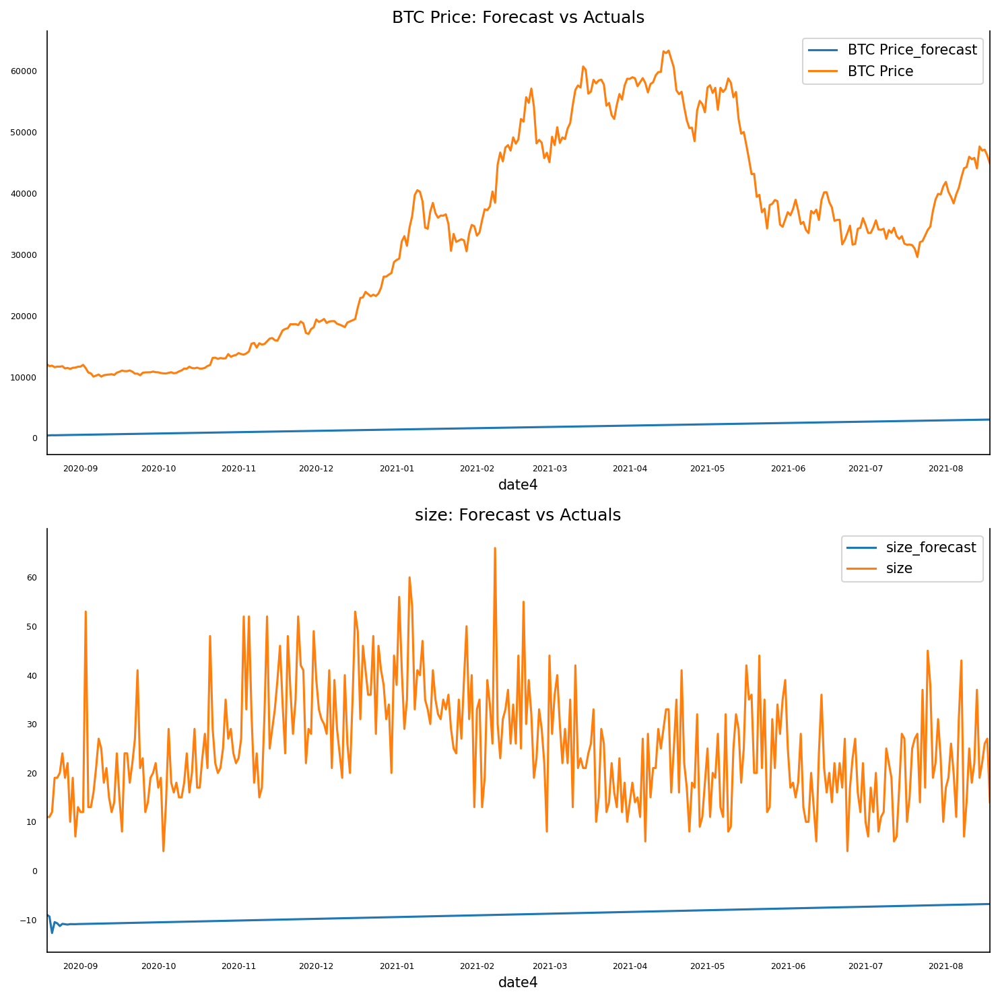

In [116]:
fig, axes = plt.subplots(nrows=int(len(dft1.columns)), ncols=1, dpi=150, figsize=(10,10))
for i, (col,ax) in enumerate(zip(dft1.columns, axes.flatten())):
    df_results[col+'_forecast'].plot(legend=True, ax=ax).autoscale(axis='x',tight=True)
    dft1_test[col][-nobs:].plot(legend=True, ax=ax);
    ax.set_title(col + ": Forecast vs Actuals")
    ax.xaxis.set_ticks_position('none')
    ax.yaxis.set_ticks_position('none')
    ax.spines["top"].set_alpha(0)
    ax.tick_params(labelsize=6)

plt.tight_layout();

# AIMAX STUFF

In [66]:
dft

,BTC Price,size,datetest,size2,rollavg_size
Date1,,,,,
2016-01-02,433.773000,0.0,0,0.0,NaN
2016-01-03,431.985000,0.0,1,0.0,NaN
2016-01-04,431.691000,0.0,2,0.0,NaN
2016-01-05,433.732000,0.0,3,0.0,NaN
2016-01-06,427.164000,0.0,4,0.0,NaN
...,...,...,...,...,...
2021-08-14,47654.729022,6.0,2036,30000.0,4.571429
2021-08-15,47004.357461,7.0,2037,35000.0,5.428571
2021-08-16,47144.842567,5.0,2038,25000.0,6.142857


In [46]:
dft1 = dft

In [47]:
dft

,BTC Price,size,datetest,size2,rollavg_size
Date1,,,,,
2016-01-02,433.773000,0.0,0,0.0,NaN
2016-01-03,431.985000,0.0,1,0.0,NaN
2016-01-04,431.691000,0.0,2,0.0,NaN
2016-01-05,433.732000,0.0,3,0.0,NaN
2016-01-06,427.164000,0.0,4,0.0,NaN
...,...,...,...,...,...
2021-08-14,47654.729022,6.0,2036,30000.0,4.571429
2021-08-15,47004.357461,7.0,2037,35000.0,5.428571
2021-08-16,47144.842567,5.0,2038,25000.0,6.142857


In [48]:
dfbtc = dft1['BTC Price']

In [49]:
dfbtc

Date1
2016-01-02      433.773000
2016-01-03      431.985000
2016-01-04      431.691000
2016-01-05      433.732000
2016-01-06      427.164000
                  ...     
2021-08-14    47654.729022
2021-08-15    47004.357461
2021-08-16    47144.842567
2021-08-17    46181.730824
2021-08-18    44887.242787
Name: BTC Price, Length: 2041, dtype: float64

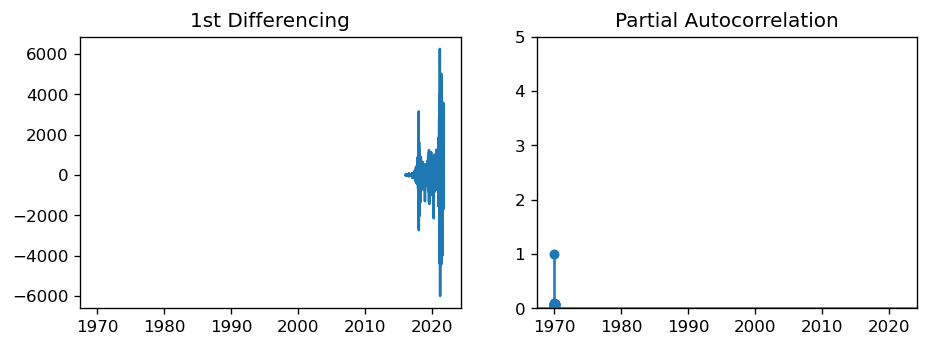

In [50]:
# PACF plot of 1st differenced series
plt.rcParams.update({'figure.figsize':(9,3), 'figure.dpi':120})

fig, axes = plt.subplots(1, 2, sharex=True)
axes[0].plot(dft1['BTC Price'].diff()); axes[0].set_title('1st Differencing')
axes[1].set(ylim=(0,5))
plot_pacf(dft1['BTC Price'].diff().dropna(), ax=axes[1])

plt.show()

In [62]:
import statsmodels.api as sm

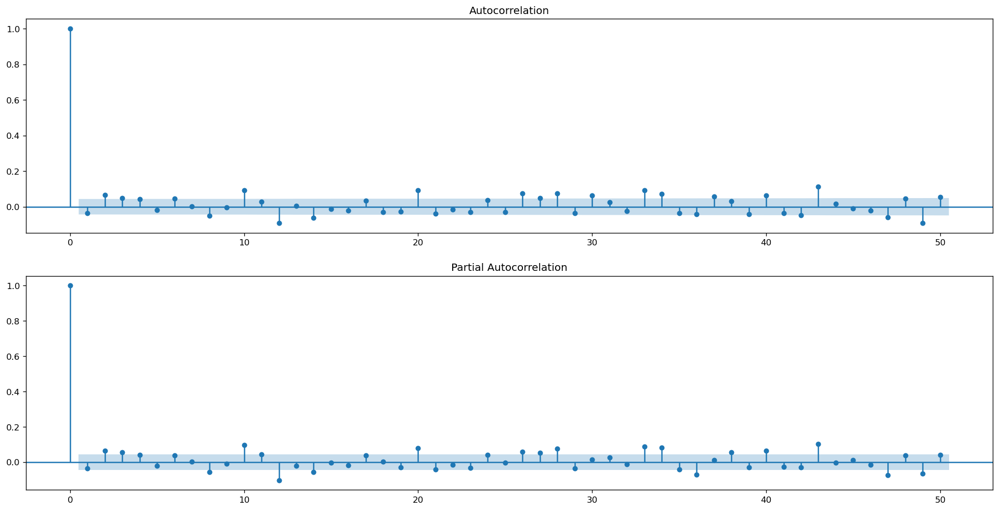

In [52]:
fig,ax = plt.subplots(2,1,figsize=(20,10))
fig = sm.graphics.tsa.plot_acf(dft1['BTC Price'].diff().dropna(), lags=50, ax=ax[0])
fig = sm.graphics.tsa.plot_pacf(dft1['BTC Price'].diff().dropna(), lags=50, ax=ax[1])
plt.show()

In [53]:
dft2 = dft1

In [54]:
df_differenced = dfbtc.diff().dropna()

In [55]:
df_differenced

Date1
2016-01-03      -1.788000
2016-01-04      -0.294000
2016-01-05       2.041000
2016-01-06      -6.568000
2016-01-07      13.857000
                 ...     
2021-08-14    3575.968349
2021-08-15    -650.371561
2021-08-16     140.485106
2021-08-17    -963.111743
2021-08-18   -1294.488036
Name: BTC Price, Length: 2040, dtype: float64

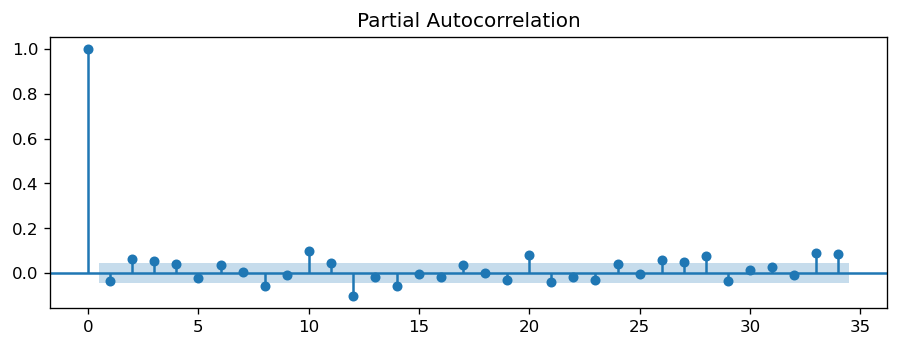

In [56]:
plot_pacf(df_differenced)
plt.show()


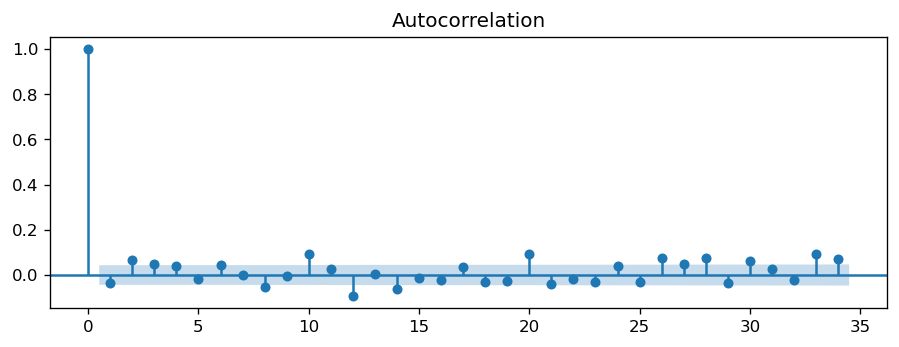

In [57]:
plot_acf(df_differenced)
plt.show()

go for p = q = 4

In [58]:
exog = dft1['size']

In [59]:


#resDiff = sm.tsa.arma_order_select_ic(dft1['BTC Price'], max_ar=7, max_ma=7, ic='aic', trend='c')
#print('ARMA(p,q) =',resDiff['aic_min_order'],'is the best.')

#this says for for 7 7 

In [60]:
nobs =  180
dft1_train, dft1_test = dft1[0:-nobs], dft1[-nobs:]

# Check size
print(dft1_train.shape)  # (119, 8)
print(dft1_test.shape)  # (4, 8)

(1861, 5)
(180, 5)


In [63]:
dft1_train

,BTC Price,size,datetest,size2,rollavg_size
Date1,,,,,
2016-01-02,433.773000,0.0,0,0.0,NaN
2016-01-03,431.985000,0.0,1,0.0,NaN
2016-01-04,431.691000,0.0,2,0.0,NaN
2016-01-05,433.732000,0.0,3,0.0,NaN
2016-01-06,427.164000,0.0,4,0.0,NaN
...,...,...,...,...,...
2021-02-15,49151.167576,8.0,1856,40000.0,6.714286
2021-02-16,48125.992195,10.0,1857,50000.0,7.000000
2021-02-17,48840.414475,19.0,1858,95000.0,8.857143


In [64]:
dft1_train.index = pd.DatetimeIndex(dft1_train.index).to_period('d')

In [119]:
arimax = sm.tsa.statespace.SARIMAX(dft1_train['BTC Price'],order=(2,1,2),seasonal_order=(0,0,0,0),exog = dft1_train['size'],
                                  enforce_stationarity=False, enforce_invertibility=False,).fit()
arimax.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:              BTC Price   No. Observations:                 1861
Model:               SARIMAX(2, 1, 2)   Log Likelihood              -14028.871
Date:                Tue, 28 Sep 2021   AIC                          28069.742
Time:                        18:46:51   BIC                          28102.902
Sample:                    01-02-2016   HQIC                         28081.964
                         - 02-19-2021                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
size         -12.7527      2.285     -5.582      0.000     -17.231      -8.275
ar.L1         -1.2070      0.006   -192.480      0.000      -1.219      -1.195
ar.L2         -0.9981      0.006   -175.639      0.000      -1.009      -0.987
ma.L1          1.2130      0.009    138.350      0.000       1.196       1.230
ma.L2          0.9569      0.008    117.091      0.000       0.941       0.973
sigma2       2.22e+05   2019.591    109.915      0.000    2.18e+05    2.26e+05
===================================================================================
Ljung-Box (L1) (Q):                   0.60   Jarque-Bera (JB):             87633.83
Prob(Q):                              0.44   Prob(JB):                         0.00
Heteroskedasticity (H):              63.03   Skew:                             0.95
Prob(H) (two-sided):                  0.00   Kurtosis:                        36.60
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [541]:
# from statsmodels.tsa.arima_model import ARIMA

# # 1,1,2 ARIMA Model
# model = ARIMA(dfbtc, order=(2,1,2))
# model_fit = model.fit(disp=0)
# print(model_fit.summary())

In [ ]:
import pmdarima as pm

# SARIMAX Model
sxmodel = pm.auto_arima(dft1_train[['BTC Price']], exogenous=dft1_train[['size']],
                           start_p=2, start_q=2,
                           test='adf',
                           max_p=7, max_q=7, m=91,
                           start_P=0, seasonal=None,
                           d=1, D=None, trace=True,
                           error_action='ignore',  
                           suppress_warnings=True, 
                           stepwise=True)

sxmodel.summary()

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,1)[91] intercept   : AIC=28114.119, Time=277.37 sec
 ARIMA(0,1,0)(0,0,0)[91] intercept   : AIC=28171.962, Time=0.14 sec
 ARIMA(1,1,0)(1,0,0)[91] intercept   : AIC=28175.857, Time=44.22 sec
 ARIMA(0,1,1)(0,0,1)[91] intercept   : AIC=28175.855, Time=28.34 sec
 ARIMA(0,1,0)(0,0,0)[91]             : AIC=28176.411, Time=1.11 sec
 ARIMA(2,1,2)(0,0,0)[91] intercept   : AIC=28108.970, Time=5.41 sec


In [ ]:
# Forecast
n_periods = 24
fitted, confint = sxmodel.predict(n_periods=n_periods, 
                                  exogenous=np.tile(seasonal_index.value, 2).reshape(-1,1), 
                                  return_conf_int=True)

index_of_fc = pd.date_range(data.index[-1], periods = n_periods, freq='MS')

# make series for plotting purpose
fitted_series = pd.Series(fitted, index=index_of_fc)
lower_series = pd.Series(confint[:, 0], index=index_of_fc)
upper_series = pd.Series(confint[:, 1], index=index_of_fc)

# Plot
plt.plot(data['value'])
plt.plot(fitted_series, color='darkgreen')
plt.fill_between(lower_series.index, 
                 lower_series, 
                 upper_series, 
                 color='k', alpha=.15)

plt.title("SARIMAX Forecast of a10 - Drug Sales")
plt.show()

In [158]:
dft1_train['forecast'] = arimax.predict()

<ipython-input-158-2cb7adf59c82>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dft1_train['forecast'] = arimax.predict()


In [160]:
arimax.plot_fit(figsize=(15,10))

AttributeError: 'SARIMAXResults' object has no attribute 'plot_fit'

In [164]:
!pip install git+https://github.com/RJT1990/pyflux

  Cloning https://github.com/RJT1990/pyflux to c:\users\t430\appdata\local\temp\pip-req-build-epb9t7gm
  Created wheel for pyflux: filename=pyflux-0.4.17-cp38-cp38-win_amd64.whl size=1364277 sha256=3d20a203345f4b25112be4b737590880b355717884e53eed3f6d8024254c66d4
  Stored in directory: C:\Users\T430\AppData\Local\Temp\pip-ephem-wheel-cache-r_kxlzac\wheels\aa\14\b1\b5b861928ef9eb74a08f8e64fe40c43aaae02edcf17f3f264a
Successfully built pyflux


  Running command git clone -q https://github.com/RJT1990/pyflux 'C:\Users\T430\AppData\Local\Temp\pip-req-build-epb9t7gm'


In [167]:
dft1_train

,BTC Price,size,datetest,size2,forecast
Date1,,,,,
2016-01-02,433.773000,0.0,0,0.0,0.000000
2016-01-03,431.985000,0.0,1,0.0,173.058754
2016-01-04,431.691000,0.0,2,0.0,333.061191
2016-01-05,433.732000,0.0,3,0.0,487.593238
2016-01-06,427.164000,0.0,4,0.0,403.020998
...,...,...,...,...,...
2021-02-15,49151.167576,0.0,1856,0.0,47965.995993
2021-02-16,48125.992195,2.0,1857,10000.0,48767.191295
2021-02-17,48840.414475,1.0,1858,5000.0,47534.666162


In [169]:
import pyflux as pf

In [174]:
dft1_train['Price'] = dft1_train['BTC Price']

In [177]:
model = pf.ARIMAX(data=dft1_train, formula='Price~1+size2',
                  ar=2, ma=2, family=pf.Normal(), integ=1)
x = model.fit("MLE")
x.summary()

Normal ARIMAX(2,1,2)                                                                                      
======================================================= ==================================================
Dependent Variable: Differenced Price                   Method: MLE                                       
Start Date: 2016-01-04                                  Log Likelihood: -14075.1134                       
End Date: 2021-02-19                                    AIC: 28164.2269                                   
Number of observations: 1858                            BIC: 28202.9177                                   
Latent Variable                          Estimate   Std Error  z        P>|z|    95% C.I.                 
======================================== ========== ========== ======== ======== =========================
AR(1)                                    0.208      0.078      2.6665   0.0077   (0.0551 | 0.3609)        
AR(2)                                

# new try
from this article https://medium.datadriveninvestor.com/time-series-prediction-using-sarimax-a6604f258c56

In [54]:
dft1.index = pd.DatetimeIndex(dft1.index).to_period('d')

In [55]:
dft1 = dft[['BTC Price', 'size']]

In [56]:
dft1

,BTC Price,size
Date1,,
2016-01-02,433.773000,0.0
2016-01-03,431.985000,0.0
2016-01-04,431.691000,0.0
2016-01-05,433.732000,0.0
2016-01-06,427.164000,0.0
...,...,...
2021-08-14,47654.729022,6.0
2021-08-15,47004.357461,7.0
2021-08-16,47144.842567,5.0


In [57]:
from sklearn.preprocessing import MinMaxScaler
sc_in = MinMaxScaler(feature_range=(0, 1)
                    )
scaled_input = sc_in.fit_transform(dft1[['size']])
scaled_input =pd.DataFrame(scaled_input)
X= scaled_input

In [58]:
sc_out = MinMaxScaler(feature_range=(0, 1))
scaler_output = sc_out.fit_transform(dft1[['BTC Price']])
scaler_output =pd.DataFrame(scaler_output)
y=scaler_output

In [59]:
train_size=int(len(dft1) *0.9)
test_size = int(len(dft1)) - train_size
train_X, train_y = X[:train_size].dropna(), y[:train_size].dropna()
test_X, test_y = X[train_size:].dropna(), y[train_size:].dropna()

In [63]:
from statsmodels.tsa.statespace.sarimax import SARIMAX


model= sm.tsa.statespace.SARIMAX(train_y, 
                                 exog=train_X,
                                 order=(2,1,2),
enforce_invertibility=False, enforce_stationarity=False)

In [64]:
results= model.fit()

C:\Users\T430\anaconda3\lib\site-packages\statsmodels\base\model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [65]:
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      0   No. Observations:                 1836
Model:               SARIMAX(2, 1, 2)   Log Likelihood                6610.488
Date:                Fri, 01 Oct 2021   AIC                         -13208.976
Time:                        10:41:16   BIC                         -13175.897
Sample:                             0   HQIC                        -13196.777
                               - 1836                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
0             -0.0035      0.001     -3.549      0.000      -0.005      -0.002
ar.L1         -1.1844      0.626     -1.893      0.058      -2.410       0.042
ar.L2         -0.4984      0.323     -1.545      0.122      -1.131       0.134
ma.L1          2.3677      0.626      3.785      0.000       1.142       3.594
ma.L2          1.9583      1.293      1.515      0.130      -0.576       4.492
sigma2      1.117e-05   1.47e-05      0.758      0.448   -1.77e-05    4.01e-05
===================================================================================
Ljung-Box (L1) (Q):                   0.00   Jarque-Bera (JB):             59793.29
Prob(Q):                              0.99   Prob(JB):                         0.00
Heteroskedasticity (H):              59.73   Skew:                            -0.33
Prob(H) (two-sided):                  0.00   Kurtosis:                        30.98
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [66]:
predictions= results.predict(start =train_size, end=train_size+test_size+(0)-1,exog=test_X)

In [67]:
test_X

,0
1836,0.354839
1837,0.612903
1838,0.483871
1839,0.354839
1840,0.419355
...,...
2036,0.193548
2037,0.225806
2038,0.161290
2039,0.258065


In [68]:
len(predictions)

205

In [69]:
test_size

205

In [70]:
forecast_1= results.forecast(steps=test_size, exog=test_X)

In [71]:
forecast_1
#same result as predictions

1836    0.507356
1837    0.506229
1838    0.506430
1839    0.507296
1840    0.506710
          ...   
2036    0.507657
2037    0.507543
2038    0.507771
2039    0.507429
2040    0.508228
Name: predicted_mean, Length: 205, dtype: float64

In [72]:
act= pd.DataFrame(scaler_output.iloc[train_size:, 0])

In [73]:
predictions=pd.DataFrame(predictions)
predictions.reset_index(drop=True, inplace=True)
predictions.index=test_X.index
predictions['Actual'] = act[0]
predictions.rename(columns={0:'Pred'}, inplace=True)

In [74]:
predictions

,predicted_mean,Actual
1836,0.507356,0.510199
1837,0.506229,0.507409
1838,0.506430,0.478993
1839,0.507296,0.524616
1840,0.506710,0.547391
...,...,...
2036,0.507657,0.750831
2037,0.507543,0.740504
2038,0.507771,0.742735
2039,0.507429,0.727442


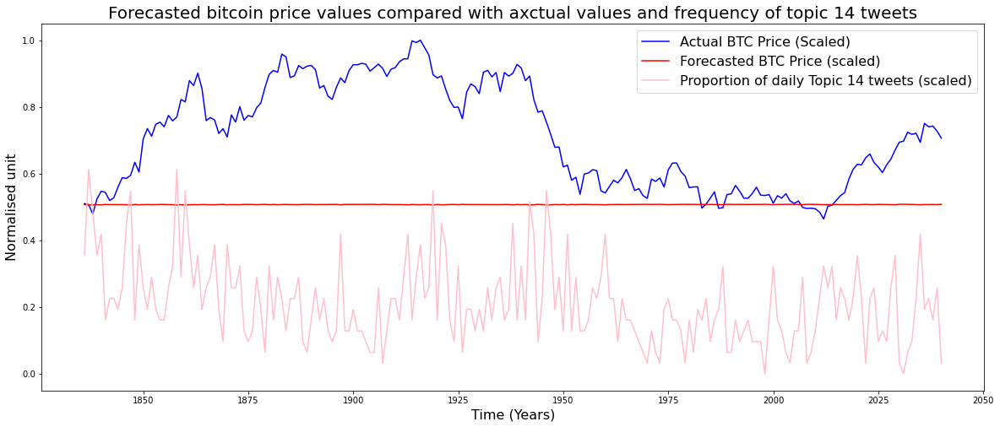

In [81]:
predictions['Actual'].plot(figsize=(20,8), legend=True, color='blue')
predictions['predicted_mean'].plot(legend=True, color='red', figsize=(20,8))
test_X[0].plot(legend=True, color='pink', figsize=(20,8))

plt.title("Forecasted bitcoin price values compared with axctual values and frequency of topic 14 tweets", fontsize = 20)
plt.xlabel('Time (Years)', fontsize=16)
plt.ylabel('Normalised unit', fontsize=16)
plt.legend(['Actual BTC Price (Scaled)','Forecasted BTC Price (scaled)', "Proportion of daily Topic 14 tweets (scaled)" ], fontsize=16)
plt.savefig(f'images/forecast.png')

In [101]:
dft1

,BTC Price,size,rollavg_size
Date1,,,
2016-01-02,-0.752948,-0.995917,NaN
2016-01-03,-0.753083,-0.995917,NaN
2016-01-04,-0.753105,-0.995917,NaN
2016-01-05,-0.752951,-0.995917,NaN
2016-01-06,-0.753448,-0.995917,NaN
...,...,...,...
2021-08-14,2.819815,0.881546,0.434531
2021-08-15,2.770608,1.194456,0.702740
2021-08-16,2.781237,0.568635,0.926247


In [44]:
X

,0
0,0.000000
1,0.000000
2,0.000000
3,0.000000
4,0.000000
...,...
2036,0.193548
2037,0.225806
2038,0.161290
2039,0.258065


In [46]:
X.to_csv(f'x.csv')

NameError: name 'results_folder' is not defined

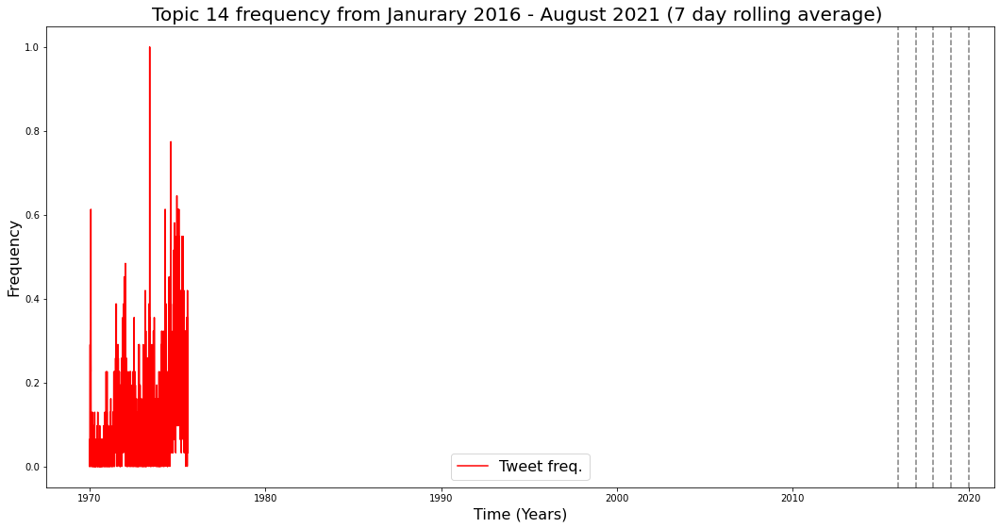

In [43]:
# do rolling average of the normalised data

plt.figure(figsize=(18,9))
BTCprice, = plt.plot(X, color='red')
#size, = plt.plot(dft['size2'], color='red')

for year in range(2016, 2021):
    plt.axvline(datetime(year,1,1), linestyle='--', color='k', alpha=0.5)
plt.title("Topic 14 frequency from Janurary 2016 - August 2021 (7 day rolling average) ", fontsize = 20)
plt.xlabel('Time (Years)', fontsize=16)
plt.ylabel('Frequency', fontsize=16)
plt.legend(['Tweet freq.'], fontsize=16)
plt.savefig(f'{results_folder}/09 - Topic tweet frequency.png')